# C-CoMP AE2504 Underway Protease kinetics

This jupyter notebook will walk you through the data processing and visualization of protease kinetics of samples taken from the Center for Chemical Currencies of a Microbial Planet cruise AE2504 using the underway system. 

The raw files are from fluorometer measurements at an excitation/emission wavelenght of λ$_{ex/em}=485/538  nm$ over time. The column names were adjusted to match the patterns used in this code. 

## Step 1: Import libraries
First we import all libraries for data import, manipulation, modeling, statistical analysis, and visualization.

In [1]:
import os
import glob
import numpy as np
import pandas as pd
import re
from numpy.polynomial import Polynomial
import matplotlib.pyplot as plt
import seaborn as sns
import csv
from collections import OrderedDict
from scipy.optimize import curve_fit
from scipy.stats import linregress
from scipy.stats import f_oneway
import matplotlib.cm as cm
import matplotlib.colors as mcolors
import matplotlib as mpl
mpl.rcParams["font.family"] = "Arial"

## CLIO DATA - IGNORE FOR UNDERWAY

In [2]:
'''
Function to load the data from MEDIA_FRACTION.txt files as dictionary values and assign to key (= growth medium). 
If successful the function will prompt: "KINETICSDATA loaded into script!"

USAGE: load_data(folder='FOLDERNAME_CONTAINING_KINETICS_TXTFILES')
'''
fluorescence_dic = {}
blank = pd.read_csv('./Kinetics/Blank_clio.txt', delimiter='\t')
blank_aebsf = pd.read_csv('./Kinetics/Blank_AEBSF.txt', delimiter='\t')
blank_edta = pd.read_csv('./Kinetics/Blank_EDTA.txt', delimiter='\t')

def load_data(folder=''):
    for file in glob.glob(os.path.join(folder, '*.txt')):
        filename = os.path.basename(file).replace('.txt', '').strip()
        sample = filename
        if 'Blank' in filename:
            print('This is the blank file. Skip and continue...')
        else:
            data = pd.read_csv(file, delimiter='\t')
            fluorescence_dic[sample] = data
            print(f"{sample} loaded into script!")
    return fluorescence_dic

FileNotFoundError: [Errno 2] No such file or directory: './Kinetics/Blank_clio.txt'

In [3]:
load_data('./Kinetics/clio055/')

clio055_51_30m loaded into script!
clio055_51_200m loaded into script!
clio055_51_50m loaded into script!
clio055_02_250m loaded into script!
clio055_51_70m loaded into script!
clio055_02_200m loaded into script!
clio055_51_250m loaded into script!
clio055_02_30m loaded into script!
clio055_02_150m loaded into script!
clio055_51_100m loaded into script!
clio055_02_50m loaded into script!
clio055_02_70m loaded into script!
clio055_51_120m loaded into script!
clio055_51_150m loaded into script!
clio055_02_120m loaded into script!
clio055_02_100m loaded into script!


{'clio055_51_30m':          Time        2        5       10       15       20       25       30  \
 0    00:00:00  248.499  236.308  250.601  246.386  252.559  244.877  236.414   
 1    00:00:30  241.331  229.932  231.326  232.288  220.058  235.674  210.495   
 2    00:01:00  234.345  221.818  220.111  224.029  213.617  228.055  204.037   
 3    00:01:30  227.717  214.285  212.429  215.506  205.487  223.996  195.161   
 4    00:02:00  219.720  205.859  209.459  209.047  197.395  209.954  184.156   
 ..        ...      ...      ...      ...      ...      ...      ...      ...   
 476  03:58:00  135.867  122.375  130.384  129.550  113.577  111.570   84.357   
 477  03:58:30  135.660  124.607  129.948  131.215  115.679  113.139   84.763   
 478  03:59:00  137.518  122.148  130.623  132.495  116.948  111.977   85.890   
 479  03:59:30  134.791  121.885  127.878  130.224  116.760  113.015   83.722   
 480  04:00:00  133.002  122.958  131.184  131.887  115.150  114.345   84.766   
 
        

In [4]:
"""
The function blank_corr() is used to subtract the blank measurements from all sample measurements. 
It takes following arguments: 
* data_dic: dictionary containing the raw data
* blank_df: dataframe containing blank measurements. 

USAGE: blank_corr(DICTIONARY_WITH_FLUORESCENCEDDATA, BLANK_DATAFRAME)
"""
def blank_corr(data_dic, blank_df=''):   
    #Subtract corresponding blank from matching columns in each dataset
        for key, df in data_dic.items():
            blankcorr = df.copy()

            for conc in ['2', '5', '10', '15', '20', '25', '30', '35', '40', '50', '60', '75']:
                # Find columns in dataset with this concentration
                conc_col = [col for col in blankcorr.columns if conc in col]
                if conc in blank_df.columns:
                    #One blank column per concentration
                    blank_series = pd.to_numeric(blank_df[conc], errors='coerce')
                else:
                    raise ValueError("Blank DataFrame must have 1, 2–3, or one column per concentration")
    
                # Subtract blank from all matching columns
                for col in conc_col:
                    blankcorr[col] = pd.to_numeric(blankcorr[col], errors='coerce') - blank_series
    
            data_dic[key] = blankcorr
            print(f"Updated {key} dataset")
        return data_dic

"""
The function normalize() is used to normalize the replicates 
"""

def normalize(df):
    normalized_df = df.copy()
    # Normalize the data to start at 0 fluorescence
    for col in df.columns:
        if col != 'Time':
            normalized_df[col] = df[col] - df[col].iloc[0]
    return normalized_df

In [5]:
corrected_dic = blank_corr(
    fluorescence_dic, 
    blank_df=blank, 
);

Updated clio055_51_30m dataset
Updated clio055_51_200m dataset
Updated clio055_51_50m dataset
Updated clio055_02_250m dataset
Updated clio055_51_70m dataset
Updated clio055_02_200m dataset
Updated clio055_51_250m dataset
Updated clio055_02_30m dataset
Updated clio055_02_150m dataset
Updated clio055_51_100m dataset
Updated clio055_02_50m dataset
Updated clio055_02_70m dataset
Updated clio055_51_120m dataset
Updated clio055_51_150m dataset
Updated clio055_02_120m dataset
Updated clio055_02_100m dataset


In [8]:
def timetomin(time_str):
        h, m, s = map(int, time_str.split(':')) 
        return h * 60 + m

In [10]:
""" FLUORESCENCE VS. TIME
This function can be used to plot the blank corrected fluorescence data against time.
Returns: plots of fluorescence vs. time in min.
By default this function will plot mean fluorescence vs. time, unless you specify in the second argument of the function 
to explicitly plot single measurements. 

ARGUMENTS: 
    * data_dic: Input dictionary with blank corrected fluorescence and time data
    * plots fluorescence vs. time
"""

def plot_flvstime(data_dic):
    
    for key, df in data_dic.items():
        # Convert time column values to units of hours using the timetohours() function and safe data to df as new column named 'Time_hr'
        df['Time_hr'] = df['Time'].apply(timetomin)
        # Normalize
        df = normalize(df)

        plt.figure(figsize=(12, 8))
        
        colors=sns.color_palette("Spectral", n_colors=12)

        # Select sample columns (exclude Time and Time_hr)
        sample_cols = [col for col in df.columns if col not in ['Time', 'Time_hr']]
        
        for i, col in enumerate(sample_cols[:12]):  # plot first 12 columns
            plt.plot(df['Time_hr'], df[col], label=col, color=colors[i])
        plt.title(f"{key}", fontsize=20)
        plt.xticks(fontsize=14)
        plt.yticks(fontsize=14)
        plt.ylim(0, 200)
        plt.xlabel("Time [min]", fontsize=16)
        plt.ylabel(r'Fluorescence Intensity Units', fontsize=16)
        plt.legend(loc='upper left', fontsize='12')
        plt.grid()
        plt.tight_layout()
        plt.savefig(f"./Kinetics/Figures/FluorescencevsTime/{key}_flvst.pdf", format='pdf')
        plt.show()

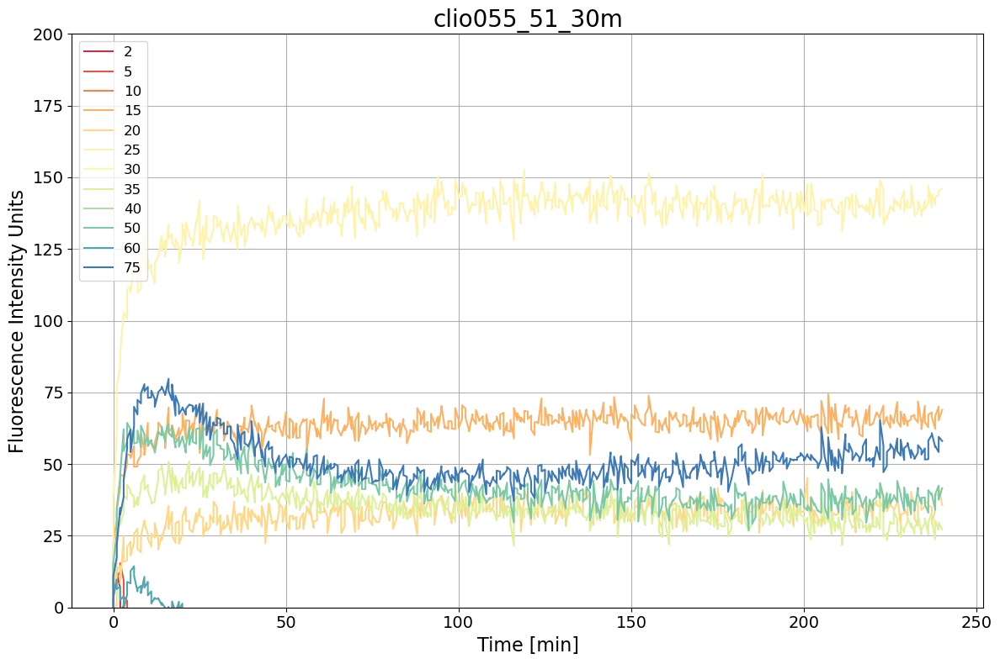

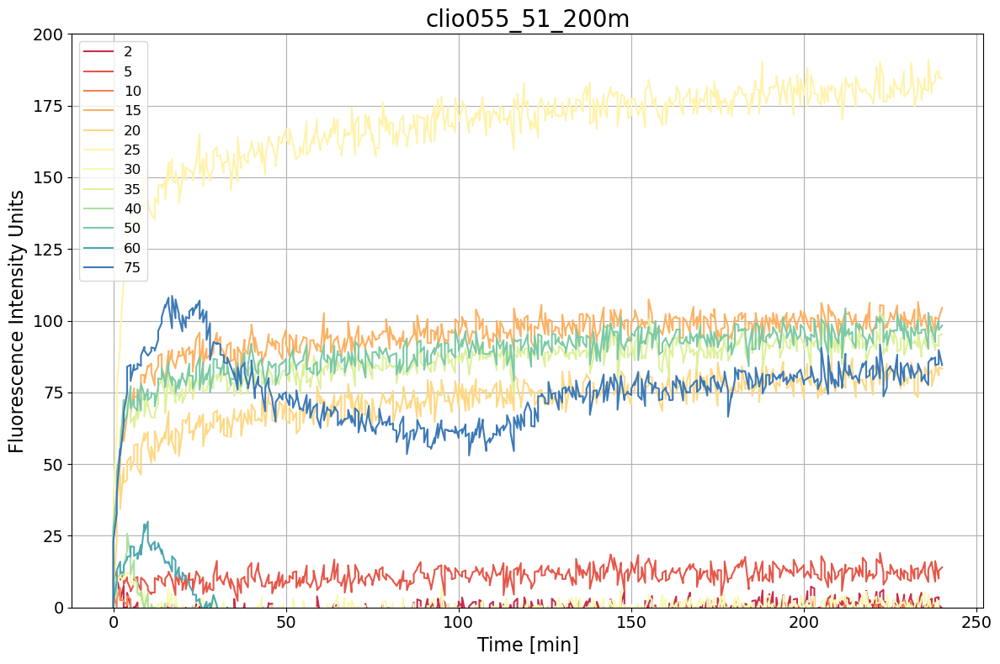

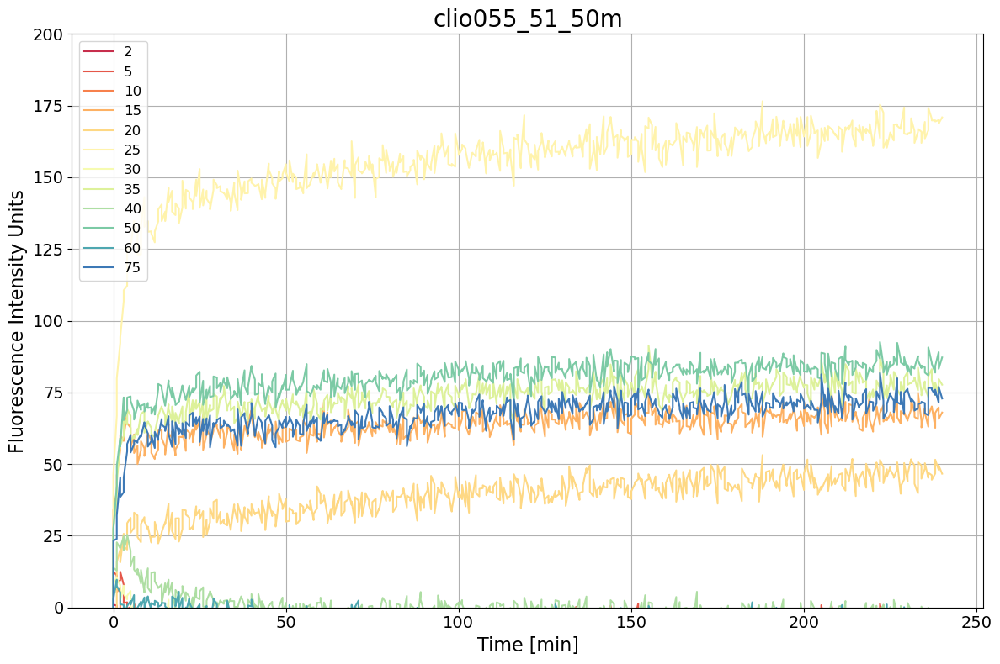

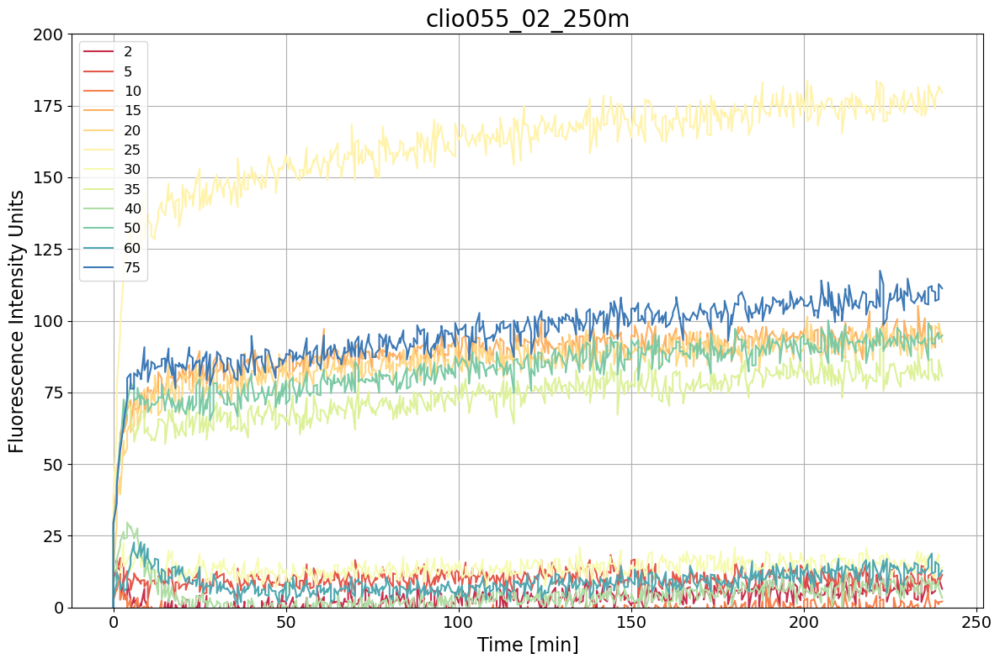

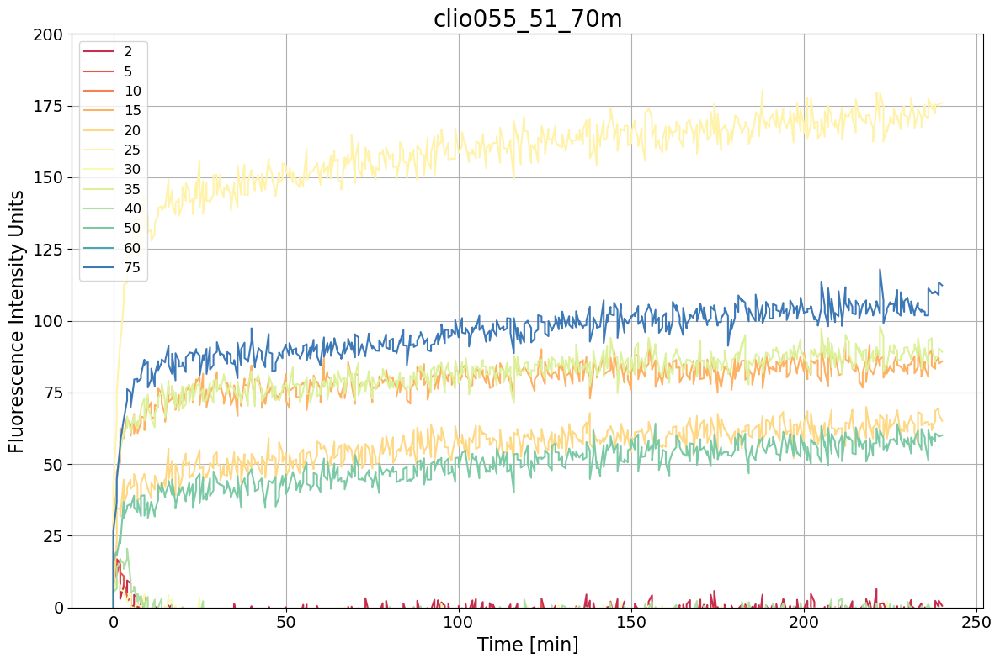

...

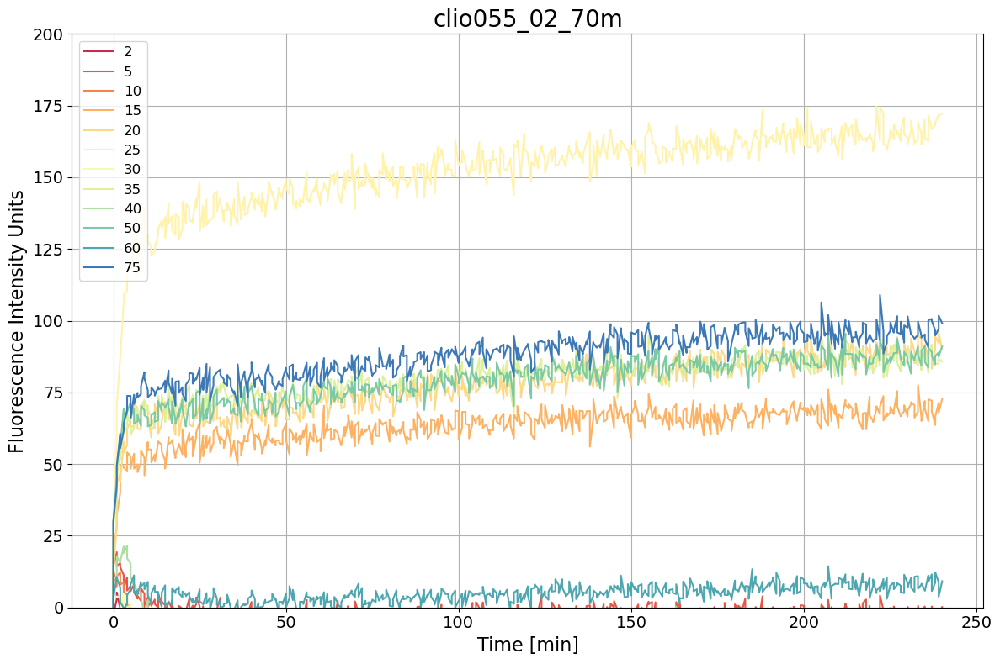

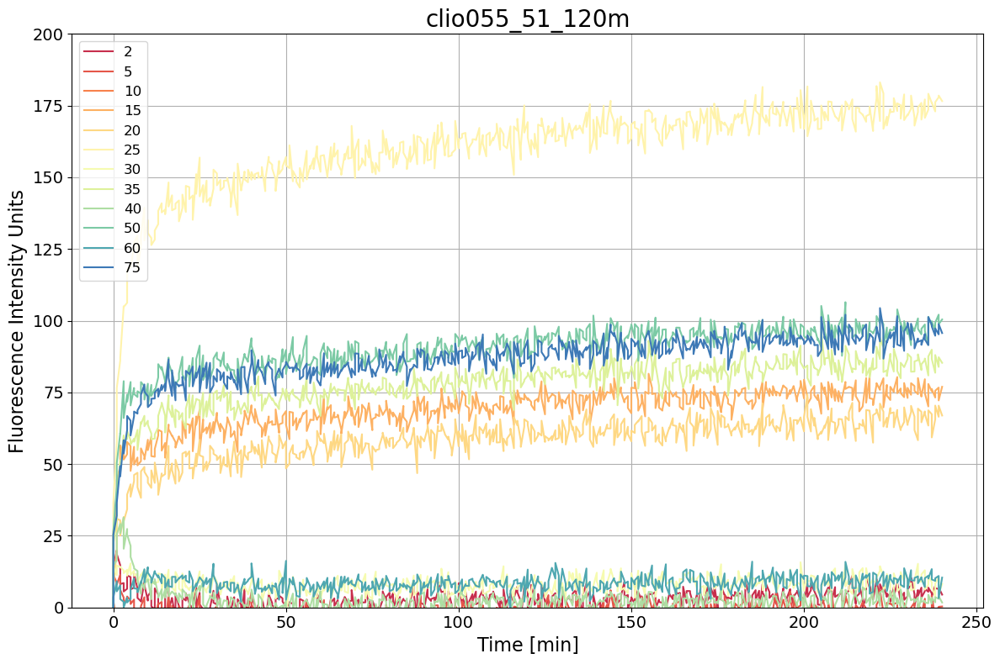

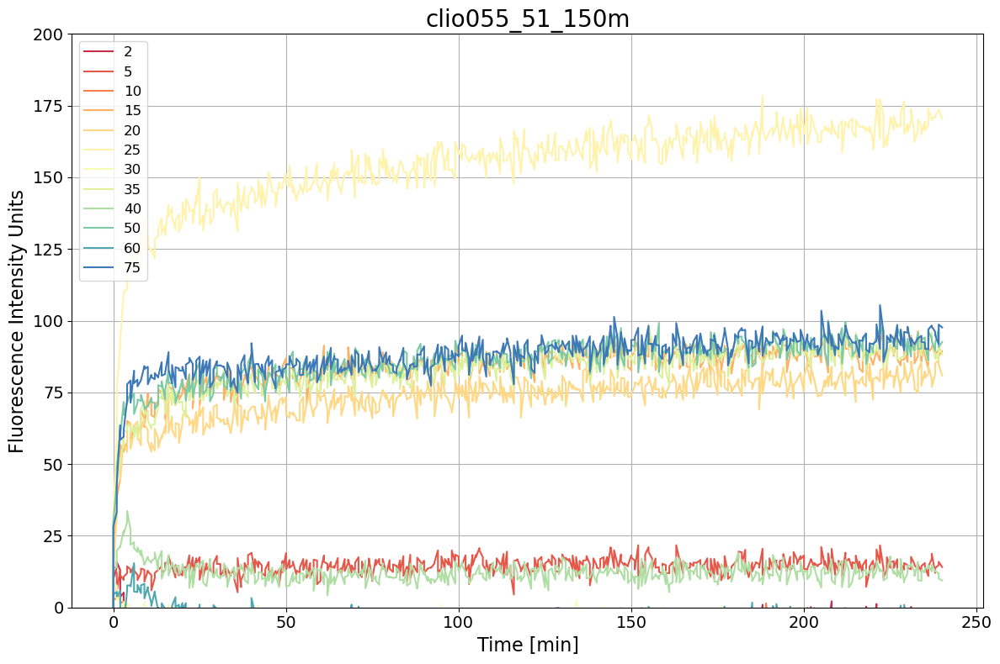

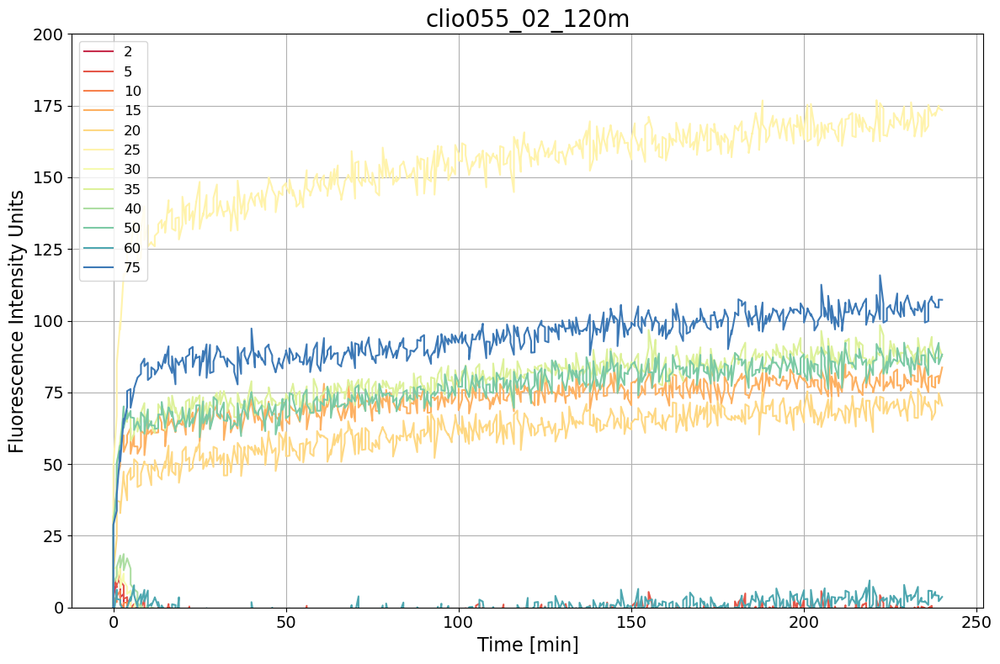

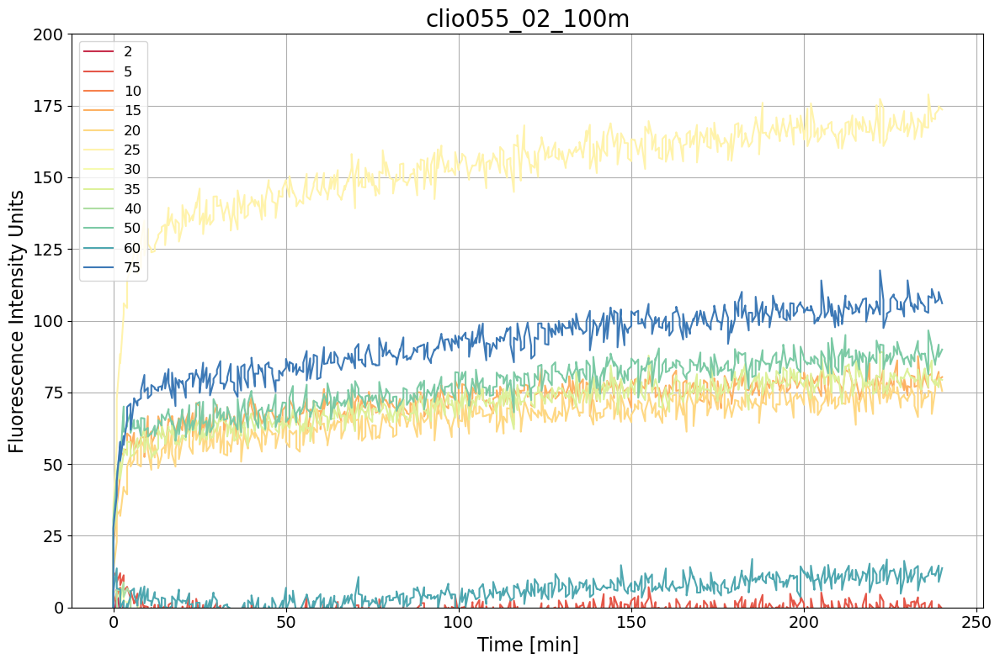

In [11]:
plot_flvstime(corrected_dic)

In [12]:
"""
The function select_degree() helps us find the best degree polynomial to fit the data without under or overfitting.
It selects this degree based on the Bayesian information criterion.
    Parameters:
        * time:
        * values: 
        * max_degree:
    Returns:
        
"""

def select_degree(time, values, max_degree=15):
    results = []

    for d in range(1, max_degree + 1):
        try:
            poly = Polynomial.fit(time, values, d)
            poly_eval = poly(time)

            # Derivative
            deriv = poly.deriv()(time)
            max_deriv = np.max(deriv)
            std_deriv = np.std(deriv)

            # Fit quality
            rss = np.sum((values - poly_eval) ** 2)
            n = len(time)
            k = d + 1  # number of parameters
            aic = n * np.log(rss/n) + 2 * k
            bic = n * np.log(rss/n) + k * np.log(n)

            results.append({
                "degree": d,
                "R²": 1 - rss / np.sum((values - np.mean(values)) ** 2),
                "AIC": aic,
                "BIC": bic,
                "max_deriv": max_deriv,
                "std_deriv": std_deriv,
                "poly": poly
            })
        except Exception as e:
            print(f"Degree {d} failed: {e}")

    # Choose based on lowest BIC or some combination
    degree = min(results, key=lambda x: x["BIC"])
    return degree, results
    
"""
This function plots fluorescence kinetics with polynomial fitting and displays fit statistics.
    Parameters:
    
    Returns:
        - fit_stats: Dictionary with max derivative and fit statistics for each condition 
"""

def plot_kinetics(data_dic):
    for key, df in data_dic.items():
        fit_stats = {}  # Dictionary to store fit statistics
        # Convert time column values to units of hours using the timetohours() function and safe data to df as new column named 'Time_hr'
        df['Time_hr'] = df['Time'].apply(timetomin)
        time = df['Time_hr']
        # Normalize
        df = normalize(df)

        # Apply Viridis color palette with length of the color palette defined by number of columns (samples)
        colors = sns.color_palette("Spectral", n_colors=len(df.columns))
        plt.figure(figsize=(15, 8))

        ## Fit a polynomial fit to the data. 
        # for each column, we assign an index with the enumerate function.
        for i, col in enumerate(df.columns[1:13]):
            # plot the fluorescence of the normalized data  vs. time. Labels and colors are based on the column that is currently run
            if col != 'Time_hr':
                plt.plot(time, df[col], label=col, color=colors[i])
                # if there are no errors, following code will be executed:
                try:
                    best_result, _ = select_degree(time, df[col])
                    degree = best_result["degree"]
                    # Polynomial fitting 
                    poly = Polynomial.fit(time, df[col], degree) #run the polynomial fit using the new Numpy Polynomial.fit and assign to poly_coeff variable
                    poly_eval = poly(time) # evaluates the polynomial by calculating the values of the coefficients at each timepoint
    
                    # Derivative and its evaluation
                    deriv_poly = poly.deriv()
                    deriv_values = deriv_poly(time)
    
                    # Max growth rate (maximal value of the derivative should be t=0)
                    slope_t0 = deriv_poly(0)
    
                    # Fit statistic - compute R^2 
                    R2 = 1 - np.sum((df[col] - poly_eval) ** 2) / np.sum((df[col] - np.mean(df[col])) ** 2)
    
                # Store all the values in a dictionary such that we can call them later.
                    fit_stats[col] = {
                        "derivative_t0": slope_t0,
                        "degree": degree,
                        "R²": R2
                    }
 
                    # Plot polynomial fit
                    plt.plot(time, poly_eval, '--', color=colors[i], alpha=0.8, label=f"{col} (Poly Fit)")

                # If there is an error in the function, it will call the exception and launch an error message. 
                except Exception as e:
                    print(f"Error in fitting polynomial for {col}: {e}")
        plt.title(f"{key}", fontsize=20)
        plt.xlabel('Time [min]')
        plt.ylabel('Fluorescence Intensity')
        plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
        plt.savefig(f"./Kinetics/Figures/Polyfit/{key}_polyfit.pdf", format='pdf')
        plt.show()
        plt.close()
    
        # Open a csv file for writing the fit statistics and extracted derivative into a file
        with open(f"./Kinetics/Figures/Polyfit/polyfit_data_{key}.csv", "w", newline="") as file:
            fieldnames = ["Condition", "derivative_t0", "degree", "R²"]
            writer = csv.DictWriter(file, fieldnames=fieldnames)
            writer.writeheader()
            for condition, stats in fit_stats.items():
                writer.writerow({"Condition": condition, **stats})
    return fit_stats

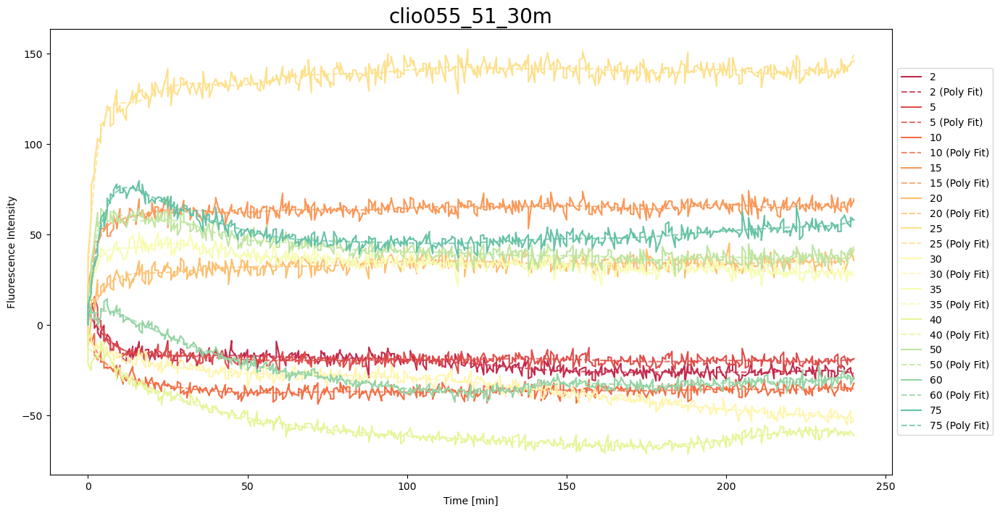

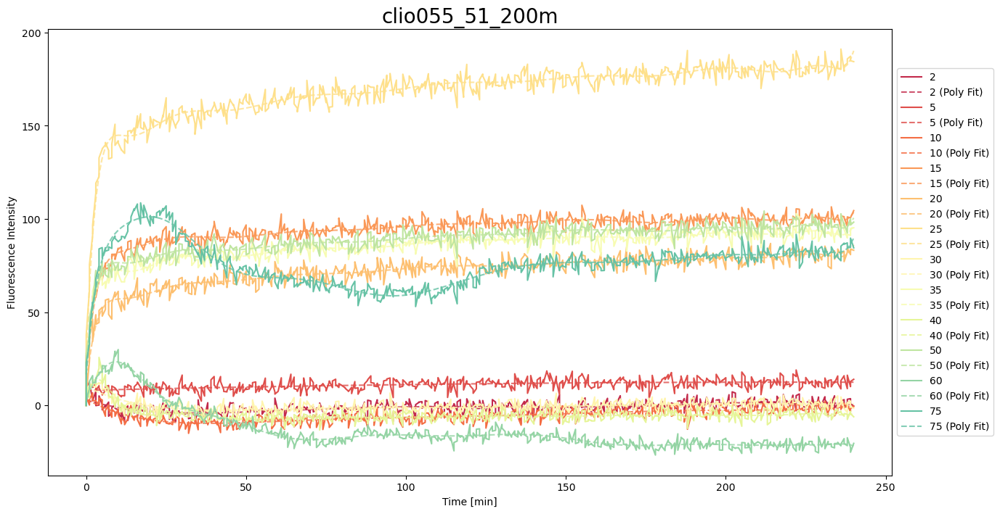

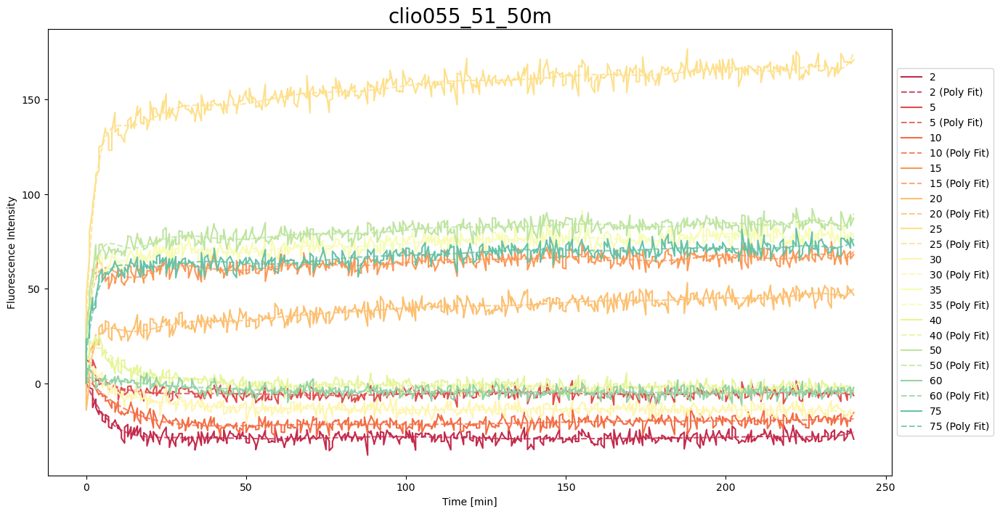

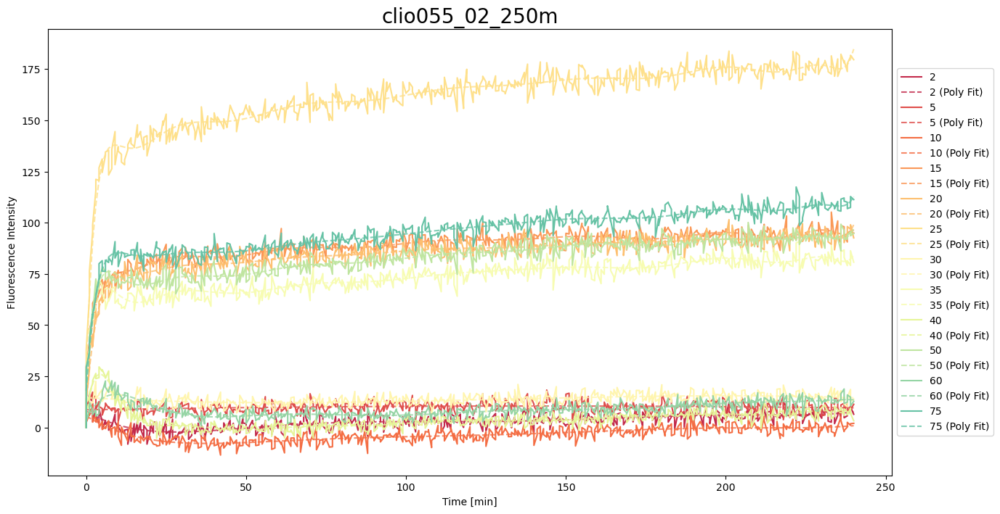

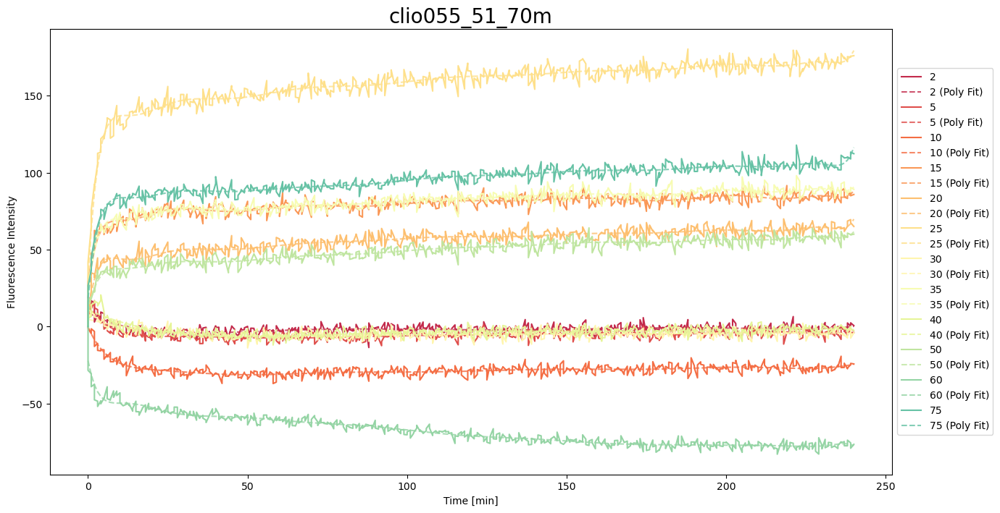

...

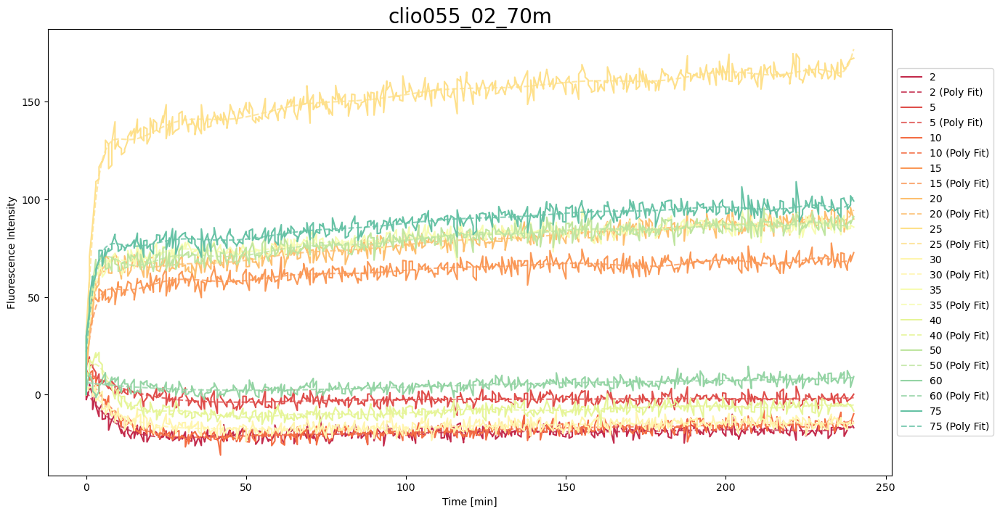

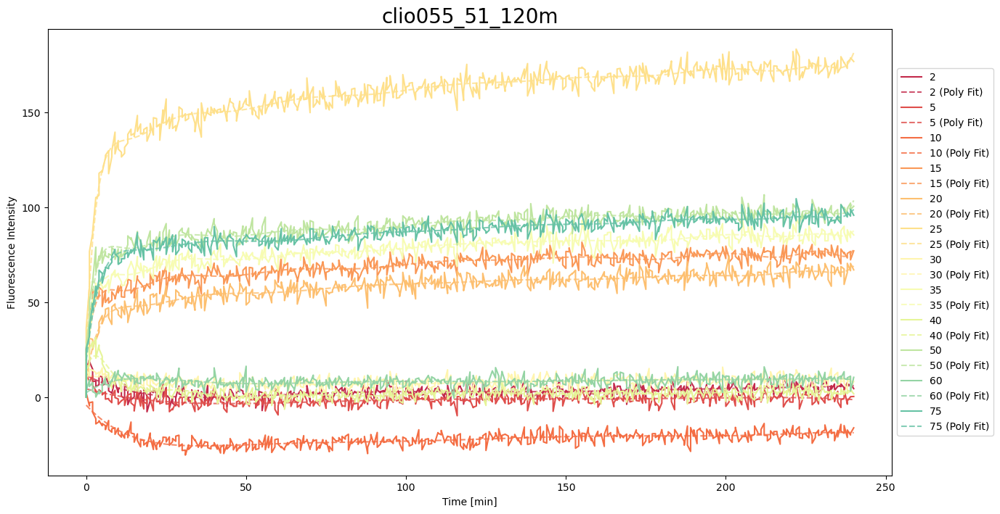

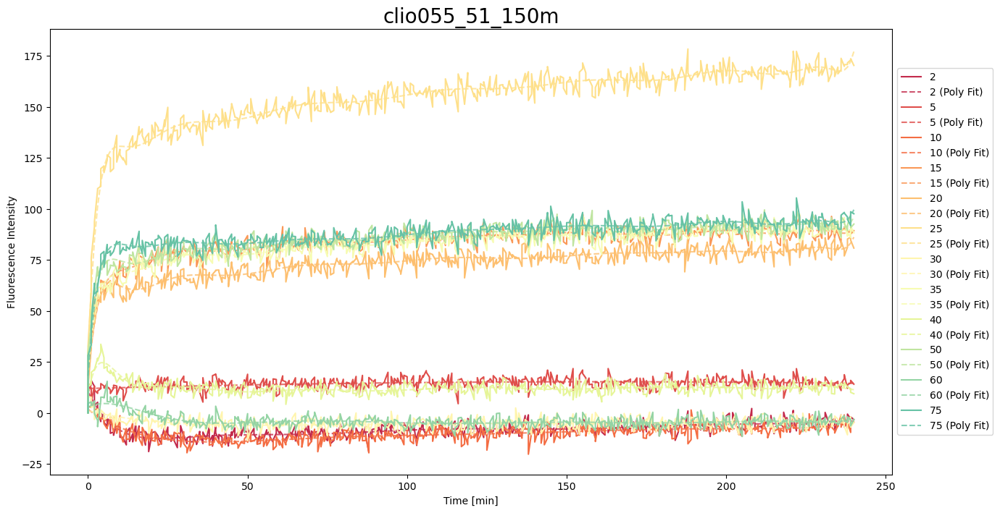

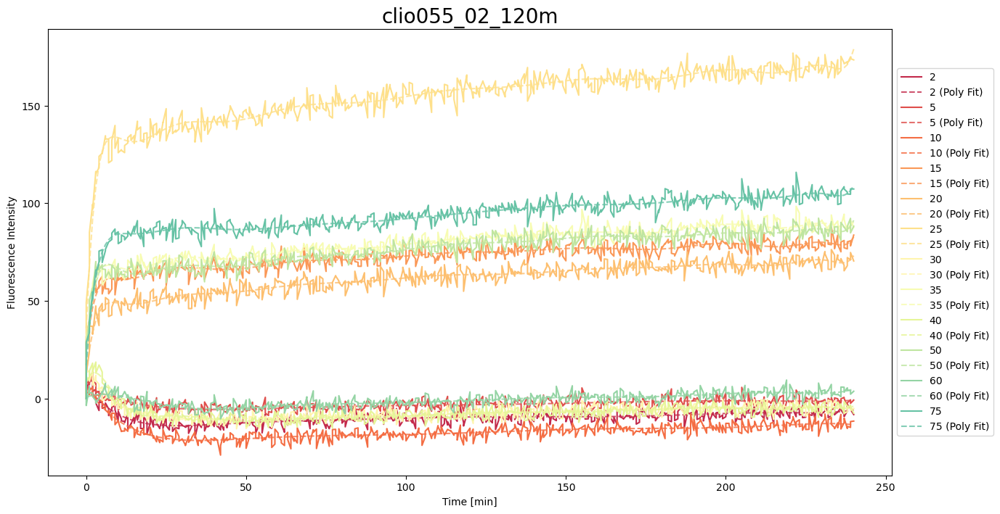

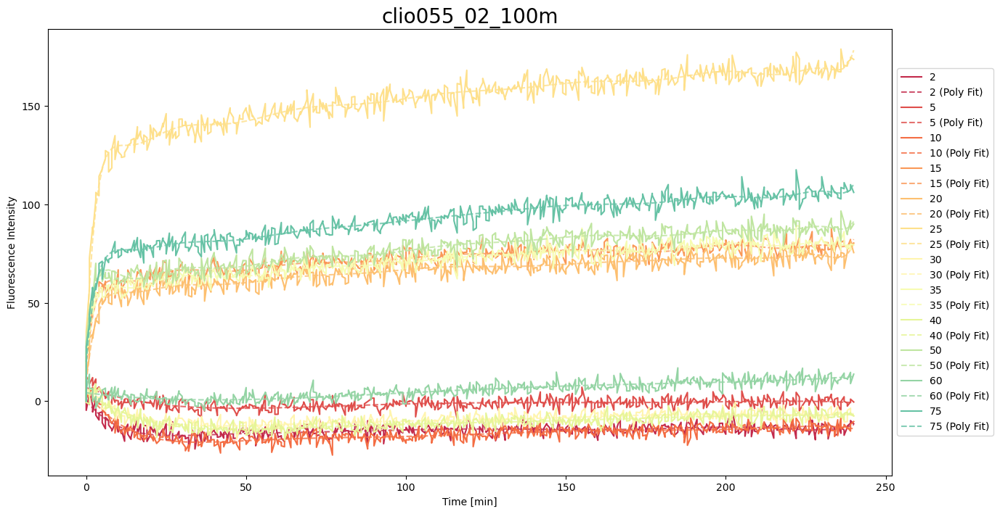

{'2': {'derivative_t0': np.float64(-2.009128661233448),
  'degree': 8,
  'R²': np.float64(0.3977672818536855)},
 '5': {'derivative_t0': np.float64(-0.5849083920513141),
  'degree': 5,
  'R²': np.float64(0.30884513946601444)},
 '10': {'derivative_t0': np.float64(-2.2178551468247494),
  'degree': 7,
  'R²': np.float64(0.6879158158290704)},
 '15': {'derivative_t0': np.float64(17.70421069648571),
  'degree': 15,
  'R²': np.float64(0.8328653555293954)},
 '20': {'derivative_t0': np.float64(15.92338669095335),
  'degree': 15,
  'R²': np.float64(0.8421368657586424)},
 '25': {'derivative_t0': np.float64(36.20506284857222),
  'degree': 15,
  'R²': np.float64(0.9395638129462462)},
 '30': {'derivative_t0': np.float64(-1.1547207224841296),
  'degree': 6,
  'R²': np.float64(0.5601787319108729)},
 '35': {'derivative_t0': np.float64(16.645985561671456),
  'degree': 15,
  'R²': np.float64(0.8593456535223342)},
 '40': {'derivative_t0': np.float64(-1.2060932524685086),
  'degree': 6,
  'R²': np.float64(0

In [13]:
plot_kinetics(corrected_dic)

In [16]:
"""
Fits Michaelis-Menten equation to initial rates extracted from polynomial slopes in previous steps (derivatives_summary.csv).
Inputs: 
    - inputfile: should be derivatives_summary.csv from previous steps. 

Outputs:
    - Figure of the Michaelis Menten fit plot in pdf format
    - 'michaelis_menten.csv' output file
    
"""
def michaelis_menten_eq(s, Vmax, Km):
    return (Vmax * s) / (Km + s)

def michaelis_menten_competition(s, Vmax, Km, I=87): # I is the inhibitor concentration which is the concentration of FTC-Casein in µM
    return (Vmax * s) / (Km * (1+(I/Km)) + s)

def michaelis_menten(inputfile='', include_mask=None):
    cond_to_conc = {2: 1, 5: 0.4, 10: 0.2, 15: 0.1333, 20: 0.1, 25: 0.08, 30: 0.0667, 35: 0.057, 40: 0.05, 50: 0.04, 60: 0.0333, 75: 0.0267 } 
    #2 µM concentration of substrate but varying amounts of protease per sample. As long as no total protein 
    # or FCM data available, correct by dividing substrate concentration by amount of sample added in µl. 
    
    ## Format dataframe
    kinetics_df = pd.read_csv(inputfile)
    initial_rates = pd.to_numeric(kinetics_df['derivative_t0'], errors='coerce')
    kinetics_df = kinetics_df.dropna(subset=['derivative_t0'])
    kinetics_df = kinetics_df[kinetics_df['derivative_t0'] >= 0]   # <-- filter out negatives
    kinetics_df['Concentration'] = kinetics_df['Condition'].map(cond_to_conc) # Replace Condition values with substrate concentrations
    
    # Store fit results for CSV export
    fit_results = []

    #datasets = list(kinetics_df["Dataset"].unique())
    #cmap = cm.get_cmap('viridis', len(datasets))
    x = kinetics_df["Concentration"].values
    y = kinetics_df["derivative_t0"].values
        
    # Fit the appropriate model

    popt, pcov = curve_fit(
        michaelis_menten_eq,
        x,
        y,
        absolute_sigma=False,
        bounds=(0, [np.inf, np.inf])
    )
    fit = michaelis_menten_eq
    Vmax, Km = popt
    y_fit = fit(x, *popt)
    ss_res = np.sum((y - y_fit) ** 2)
    ss_tot = np.sum((y - np.mean(y)) ** 2)
    r_squared = 1 - (ss_res / ss_tot)
    perr = np.sqrt(np.diag(pcov))
    Vmax_err, Km_err = perr
    fit_results.append({
        "Vmax (µM/min)": f"{Vmax:.4f} ± {Vmax_err:.4f}",
        "Km (µM)": f"{Km:.4f} ± {Km_err:.4f}",
        "R2": r_squared
    })

    # Plotting
    name = os.path.basename(inputfile).replace('.csv', '').strip()
    fig, ax = plt.subplots(figsize=(8, 6))
    ax.errorbar(x, y, fmt='o', capsize=4, label="Data")
    x_fit = np.linspace(0, 1, 200)
    ax.plot(x_fit, fit(x_fit, *popt), label="Fit")
    ax.set_xlabel("Substrate concentration (µM)")
    ax.set_ylabel("Initial rate (v₀)")
    ax.set_title(name)
    ax.grid(True)
    ax.legend()

    # Annotate with Vmax and Km
    ax.annotate(
        f"Vmax = {Vmax:.2f} ± {Vmax_err:.2f}\n"
        f"Km = {Km:.2f} ± {Km_err:.2f}\n"
        f"R² = {r_squared:.3f}",
        xy=(0.05, 0.95),  # Coordinates relative to axes (5% from left, 95% from bottom)
        xycoords='axes fraction',
        ha='left', va='top',
        fontsize=12,
        bbox=dict(boxstyle='round,pad=0.3', edgecolor='gray', facecolor='white', alpha=0.8)
    )

    # Save figure per dataset
    plt.tight_layout()
    plt.savefig(f"./Kinetics/Figures/MM_Kinetics/michaelis_{name}.pdf", format='pdf')
    plt.show()

    # Save fit parameters to CSV
    pd.DataFrame(fit_results).to_csv(f"./Kinetics/Figures/MM_Kinetics/michaelis_menten_{name}.csv", index=False)

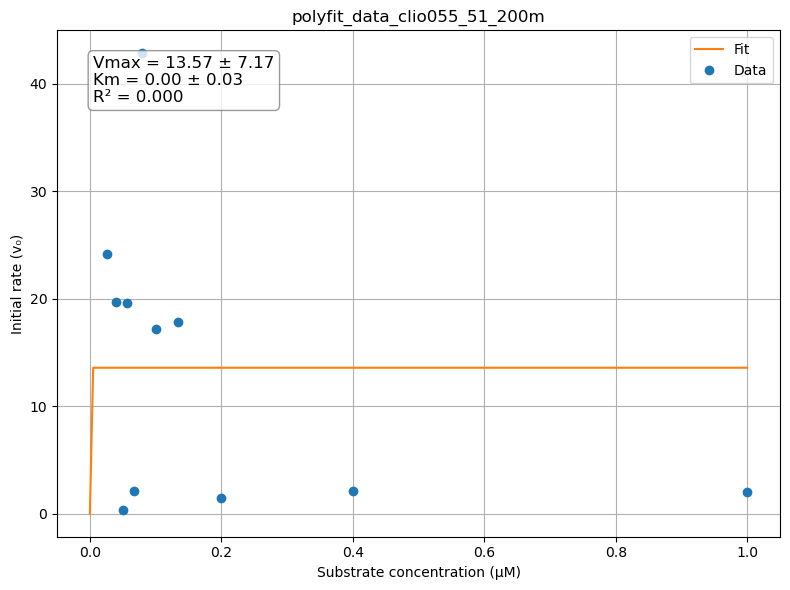

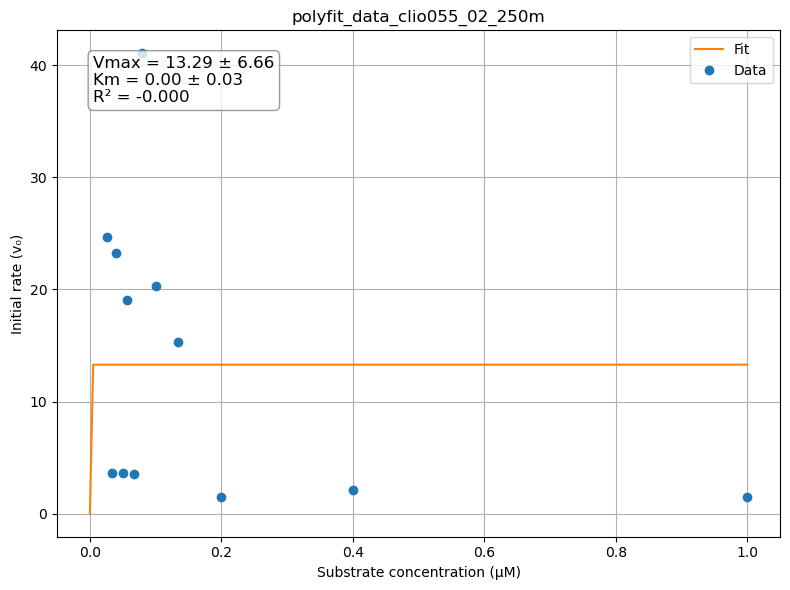

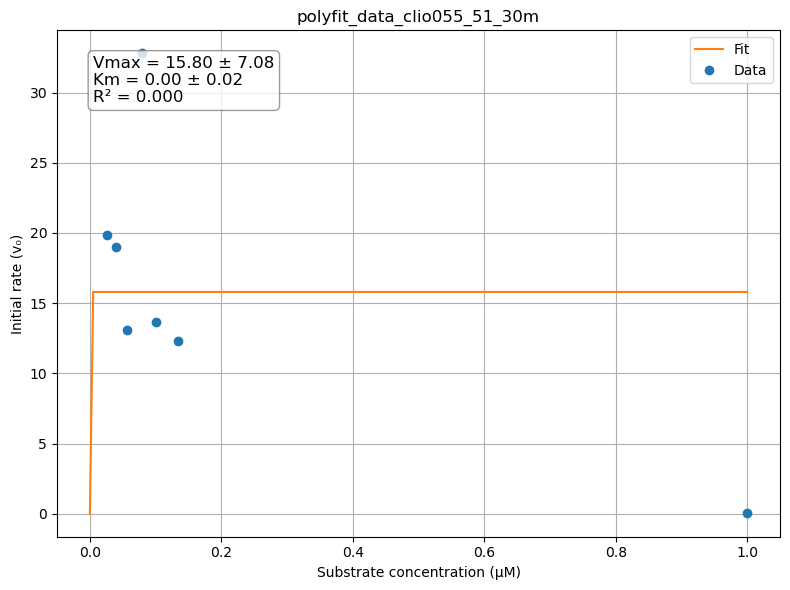

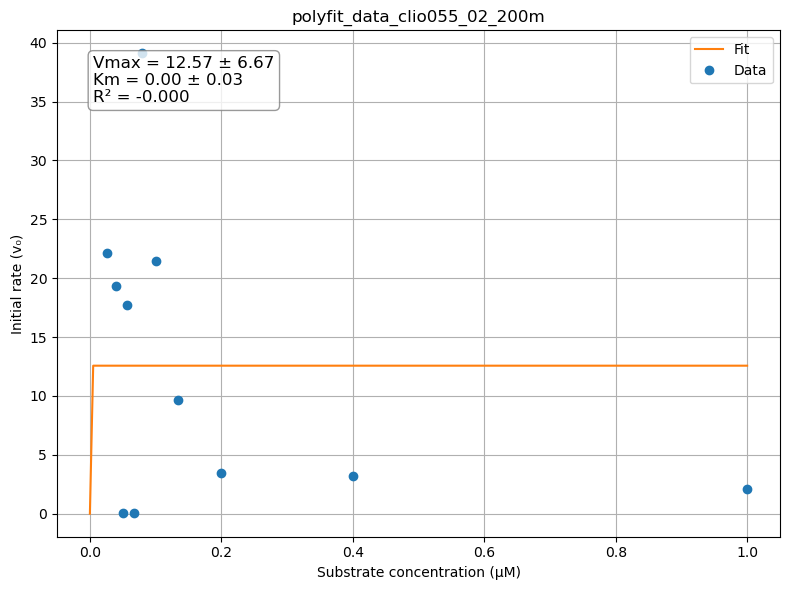

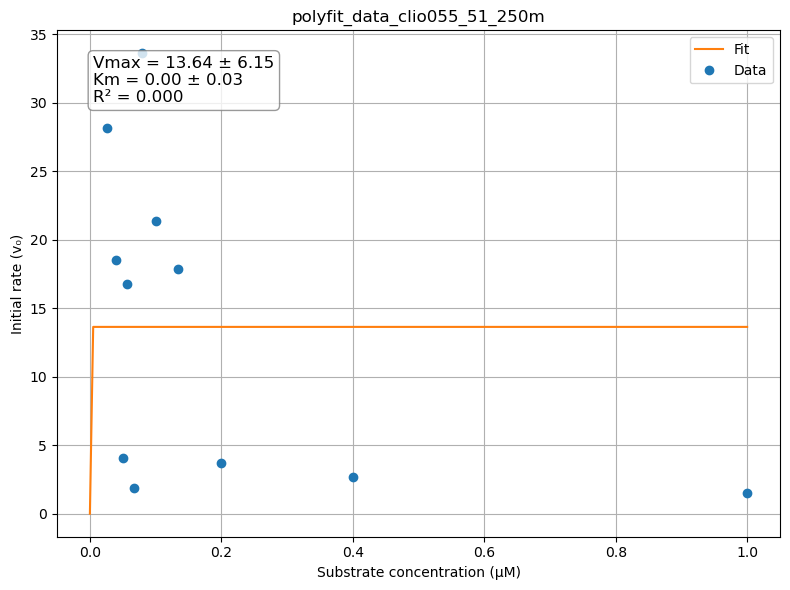

...

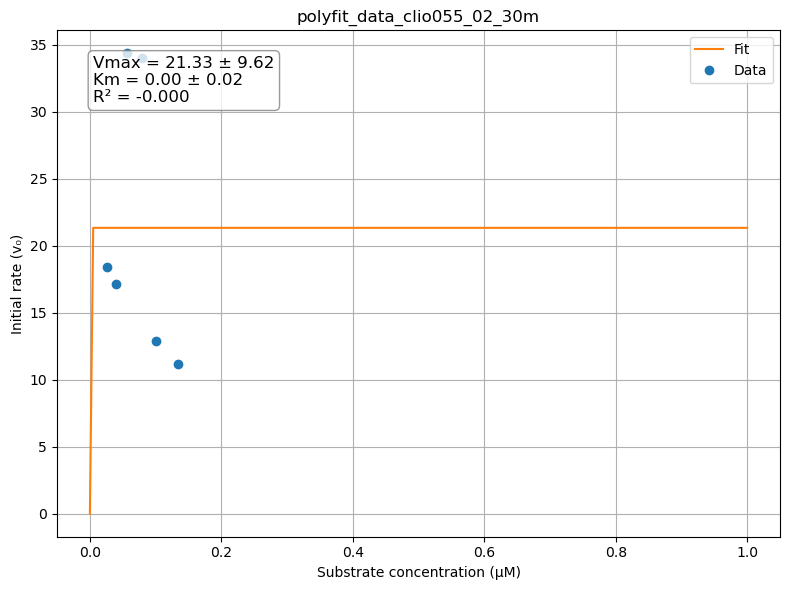

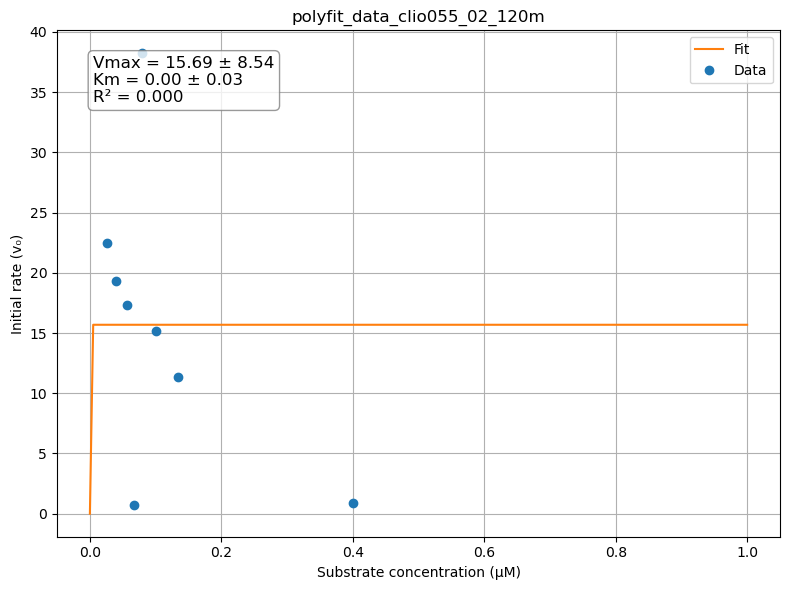

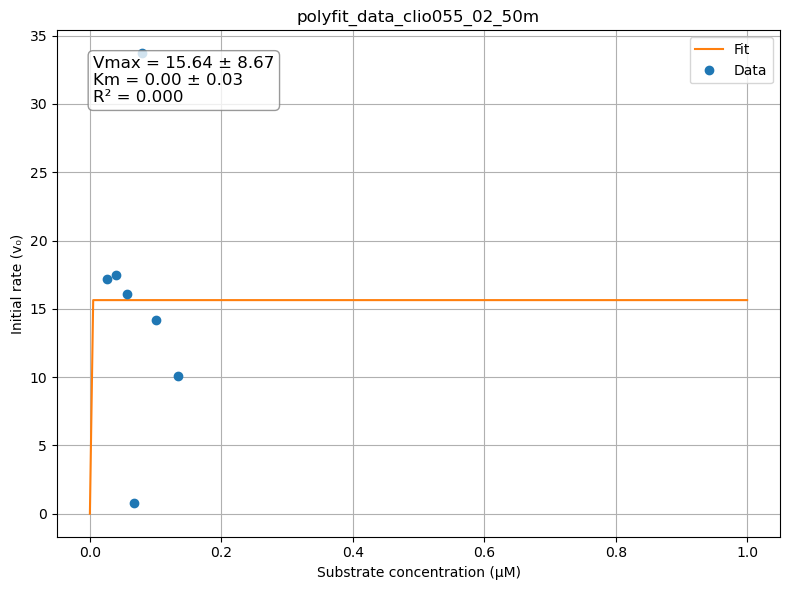

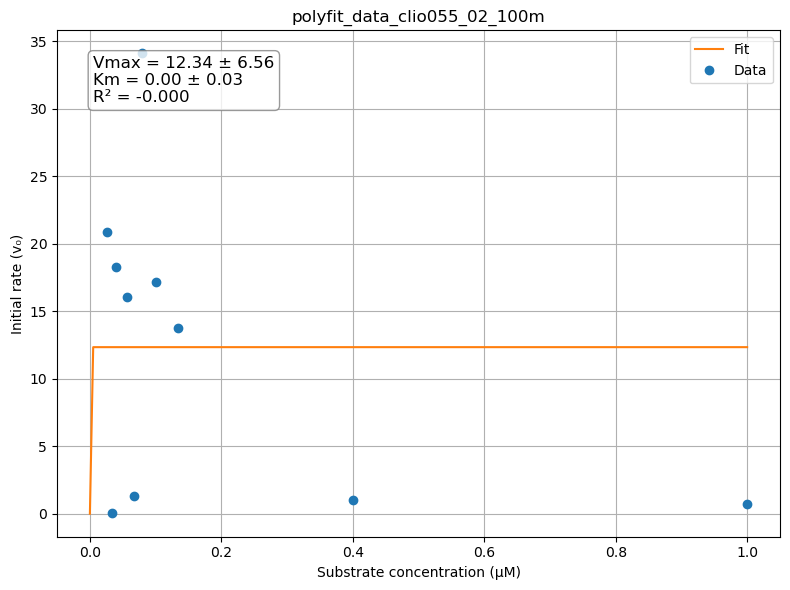

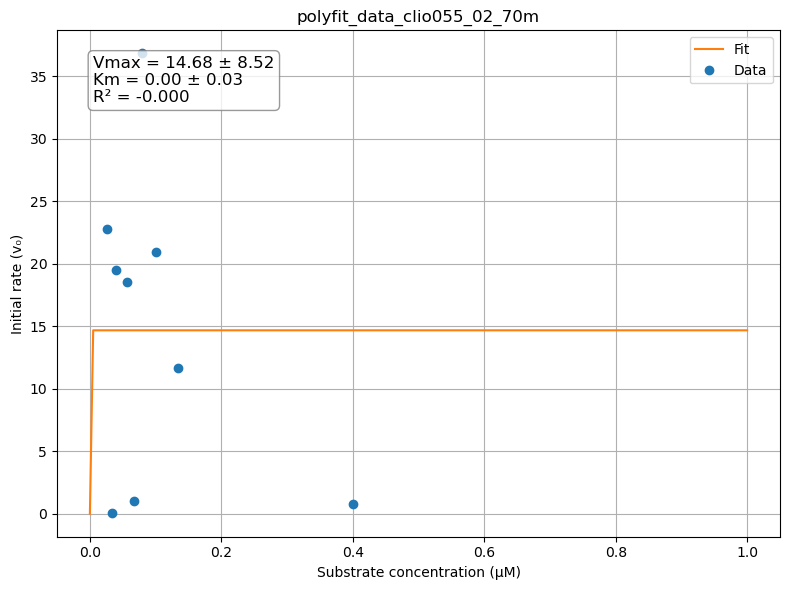

In [17]:
for file in glob.iglob('./Figures/Polyfit/*.csv'):
    michaelis_menten(file)


## Step 2: Data Import and Blank correction
The following functions can be used to determine the blanks and subtract them from the measurements. Each sample (i.e. 1/8 of a 142 mm, 51 µm or 0.2 µm filter from CLIO or Underway sampling) is one row in the sampling scheme. The following functions can be used to determine the blanks in triplicate and subtract them from the triplicate measurements. The functions assumue, that there are three individual blank measurement for each of the four substrate concentrations - 0.5 µM (25 µL), 1 µM (50 µL), 2 µM (100 µL), and 3 µM (150 µL) - for normal measurements `blank_corr()`.

The name of the file should be 'Sampletype_filtersize' (f.e. UW3_02 or clio055_02) or 'Sampletype_filtersize_Inhibitor' (f.e. clio056_51_AEBSF).

In [2]:
'''
Function to load the data from MEDIA_FRACTION.txt files as dictionary values and assign to key (= growth medium). 
If successful the function will prompt: "KINETICSDATA loaded into script!"

USAGE: load_data(folder='FOLDERNAME_CONTAINING_KINETICS_TXTFILES')
'''
fluorescence_dic = {}

blank= pd.read_csv('../data/Kinetics/UW28_Blank.txt', delimiter='\t')

def load_data(folder=''):
    for file in glob.glob(os.path.join(folder, '*.txt')):
        filename = os.path.basename(file).replace('.txt', '').strip()
        sample = filename
        if 'Blank' in filename:
            print('This is the blank file. Skip and continue...')
        else:
            data = pd.read_csv(file, delimiter='\t')
            fluorescence_dic[sample] = data
            print(f"{sample} loaded into script!")
    return fluorescence_dic

In [3]:
load_data('../data/Kinetics/raw/')

UW103_51 loaded into script!
UW75_51 loaded into script!
UW85_02 loaded into script!
UW89_02 loaded into script!
UW96_51 loaded into script!
UW74_02 loaded into script!
UW77_51 loaded into script!
UW99_02 loaded into script!
UW70_02 loaded into script!
UW73_51 loaded into script!
UW93_02 loaded into script!
UW71_51 loaded into script!
UW107_51 loaded into script!
UW82_51 loaded into script!
UW77_02 loaded into script!
UW99_51 loaded into script!
UW96_02 loaded into script!
UW74_51 loaded into script!
UW103_02 loaded into script!
UW75_02 loaded into script!
UW85_51 loaded into script!
UW89_51 loaded into script!
UW82_02 loaded into script!
UW93_51 loaded into script!
UW28_02 loaded into script!
UW71_02 loaded into script!
UW107_02 loaded into script!
UW73_02 loaded into script!
UW70_51 loaded into script!


{'UW103_51':          Time     25_1     25_2     25_3     50_1     50_2     50_3    100_1  \
 0    00:00:00   98.765   94.148   98.916  181.518  174.655  169.365  346.663   
 1    00:00:30  110.226  104.528  104.680  190.515  180.761  178.218  346.699   
 2    00:01:00   92.944   92.727   96.573  178.332  169.883  161.818  334.378   
 3    00:01:30   91.783   91.173   95.961  180.039  165.603  163.209  325.313   
 4    00:02:00   92.429   89.914   91.435  179.540  164.391  162.326  325.337   
 ..        ...      ...      ...      ...      ...      ...      ...      ...   
 236  01:58:00   60.065   59.735   58.026  135.874  132.894  124.152  323.058   
 237  01:58:30   59.816   57.853   57.913  138.353  133.695  125.938  321.575   
 238  01:59:00   59.753   57.716   58.054  136.504  131.581  123.960  321.992   
 239  01:59:30   59.343   58.259   58.333  136.812  131.948  125.158  322.679   
 240  02:00:00   59.764   58.031   58.320  136.925  133.330  125.888  324.884   
 
        100_2 

In [4]:
"""
The function blank_corr() is used to subtract the mean of the blank measurements from all triplicates. 
It takes following arguments: 
* data_dic: dictionary containing the raw data
* blank_df: dataframe containing blank measurements. 

USAGE: blank_corr(DICTIONARY_WITH_FLUORESCENCEDDATA, BLANK_DATAFRAME)
"""
def blank_corr(data_dic, blank_df=''):   
    # Extract the blank columns, and calculate mean blank series per concentration
    blank_means = {
        '25': blank_df.loc[:, '25_1':'25_3'].mean(axis=1),
        '50': blank_df.loc[:, '50_1':'50_3'].mean(axis=1),
        '100': blank_df.loc[:, '100_1':'100_3'].mean(axis=1),
        '150': blank_df.loc[:, '150_1':'150_3'].mean(axis=1)
    }
    #Subtract corresponding blank from matching columns in each dataset
    for key, df in data_dic.items():
        blankcorr = df.copy()
        for conc in ['25', '50', '100', '150']:
            blank_series = blank_means[conc]
            # Identify the columns that contain the concentration label (e.g., '25_1', '25_2', '25_3')
            conc_col = [col for col in blankcorr.columns if conc in col]
            for col in conc_col:
                blankcorr[col] = pd.to_numeric(blankcorr[col], errors='coerce') - blank_series

        data_dic[key] = blankcorr
        print(f"Updated {key} dataset")
    return data_dic

In [5]:
blank_corr(fluorescence_dic, blank);

Updated UW103_51 dataset
Updated UW75_51 dataset
Updated UW85_02 dataset
Updated UW89_02 dataset
Updated UW96_51 dataset
Updated UW74_02 dataset
Updated UW77_51 dataset
Updated UW99_02 dataset
Updated UW70_02 dataset
Updated UW73_51 dataset
Updated UW93_02 dataset
Updated UW71_51 dataset
Updated UW107_51 dataset
Updated UW82_51 dataset
Updated UW77_02 dataset
Updated UW99_51 dataset
Updated UW96_02 dataset
Updated UW74_51 dataset
Updated UW103_02 dataset
Updated UW75_02 dataset
Updated UW85_51 dataset
Updated UW89_51 dataset
Updated UW82_02 dataset
Updated UW93_51 dataset
Updated UW28_02 dataset
Updated UW71_02 dataset
Updated UW107_02 dataset
Updated UW73_02 dataset
Updated UW70_51 dataset


## Step 3: Functions to be used for data preparation
Before we can plot our data, we need to normalize, calculate mean and standard deviation and convert the time to a format that can be used by matplotlib to plot. We therefore create the functions normalize() and mean_std() that can be used in downstream plots.

In [6]:
"""
The function normalize() is used to normalize the replicates 
The function mean() is used to calculate the mean of triplicate measurements for plotting 
Parameters: 
    * data_dic: dictionary containing blank corrected fluorescence data

"""
def normalize(df):
    normalized_df = df.copy()
    # Normalize the data to start at 0 fluorescence
    for col in df.columns:
        if col != 'Time':
            normalized_df[col] = df[col] - df[col].iloc[0]
    return normalized_df

def mean_std(df):
    time = df.iloc[:, 0]
    meanstd = pd.DataFrame({'Time': time})

    for i in range(4):
        start = 1+ i * 3
        end= start + 3
        triplicates = df.iloc[:, start:end]

        means = triplicates.mean(axis=1)
        stds = triplicates.std(axis=1)

        meanstd[f'Sample_{i+1}_mean'] = means
        #meanstd[f'Sample_{i+1}_std'] = stds
    return meanstd

def timetomin(time_str):
        h, m, s = map(int, time_str.split(':')) 
        return h * 60 + m

## Step 4: Rate determination and plotting

Finally, we want to quality control our triplicate measurements by plotting either triplicates and/or mean against time, and eventually extract fluorescence kinetics from the rate determined at t=0. 

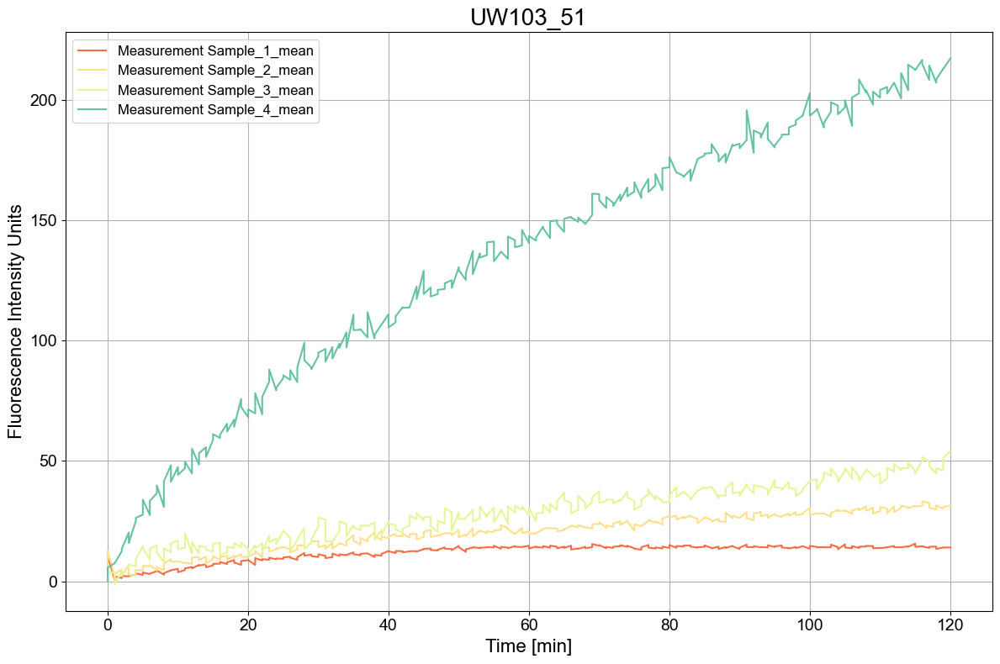

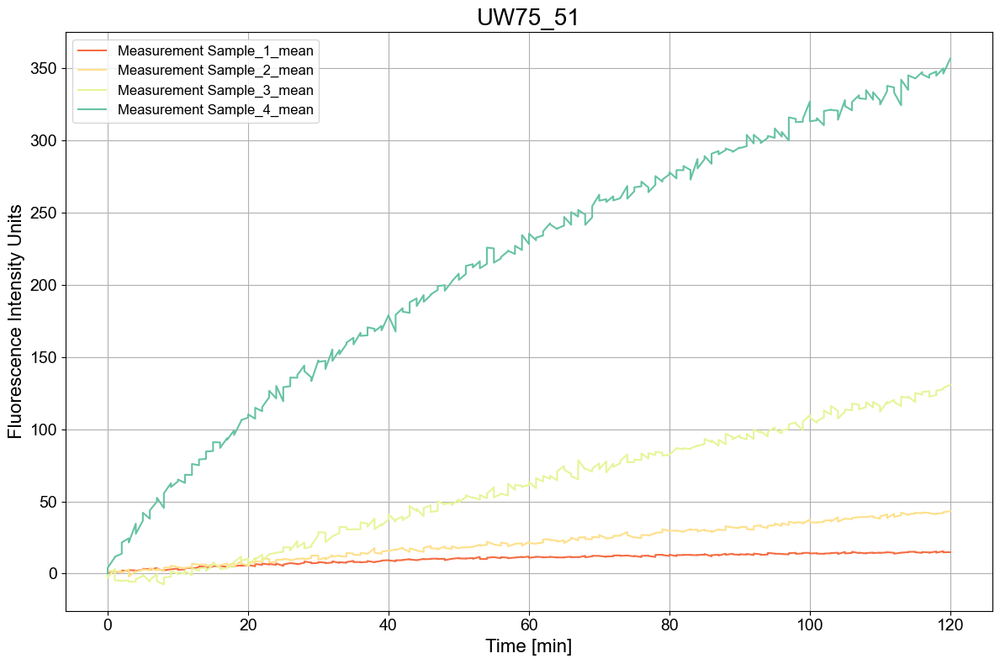

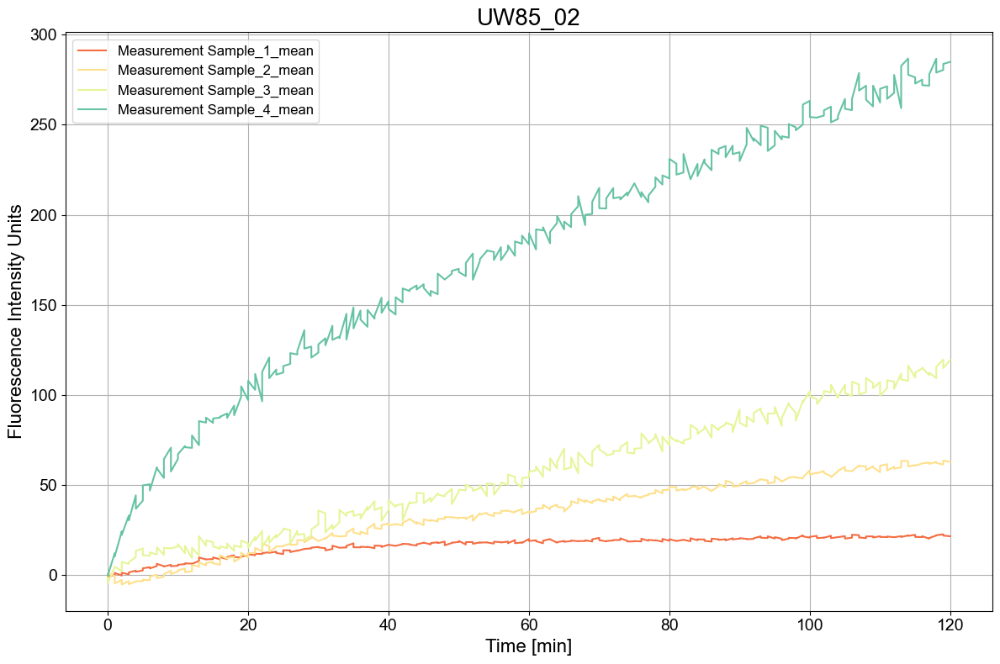

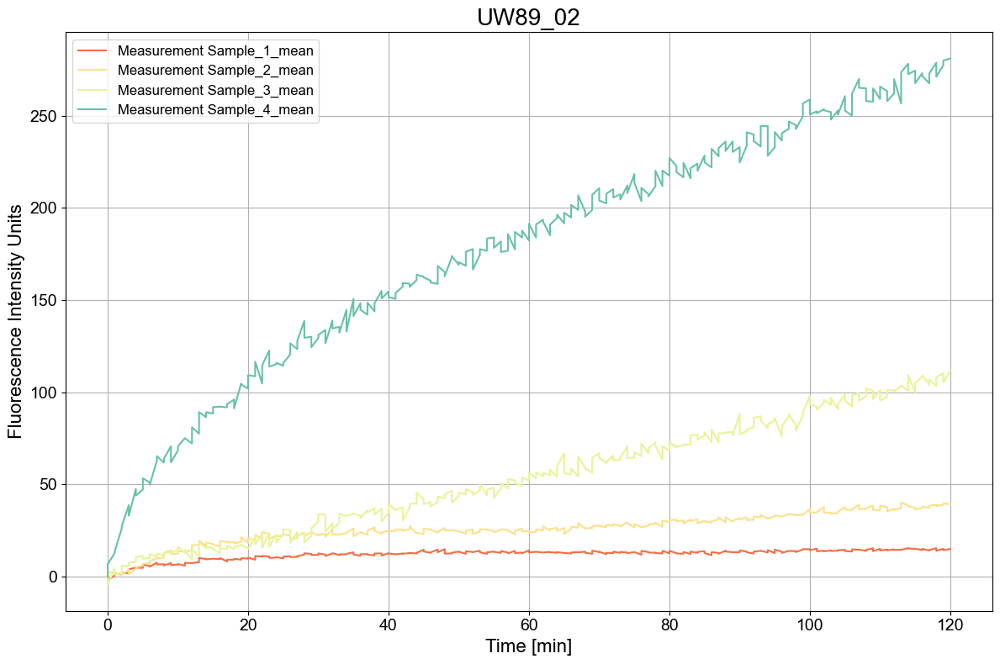

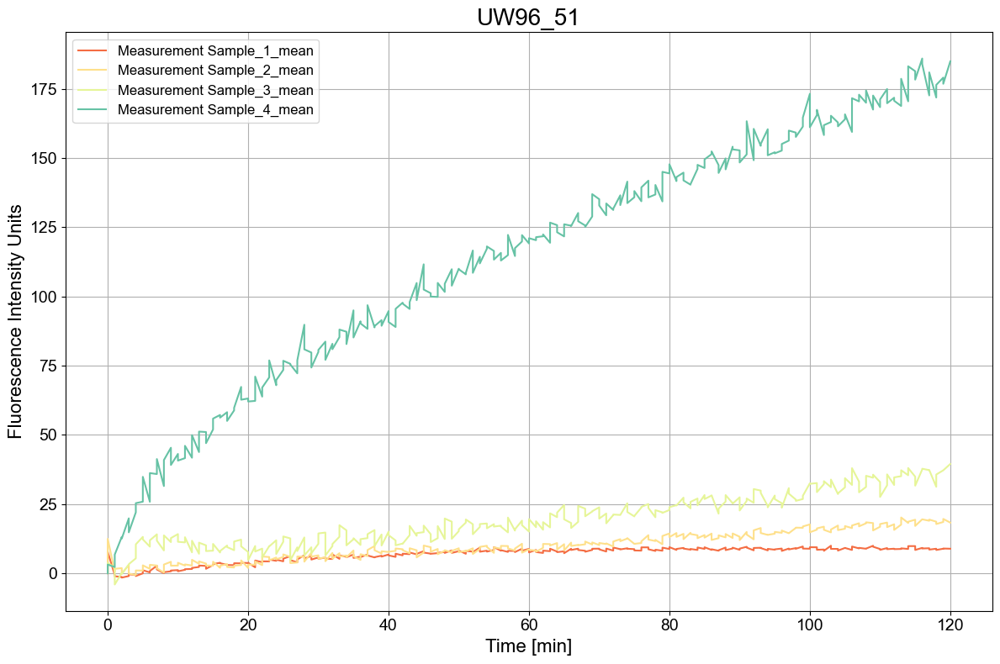

...

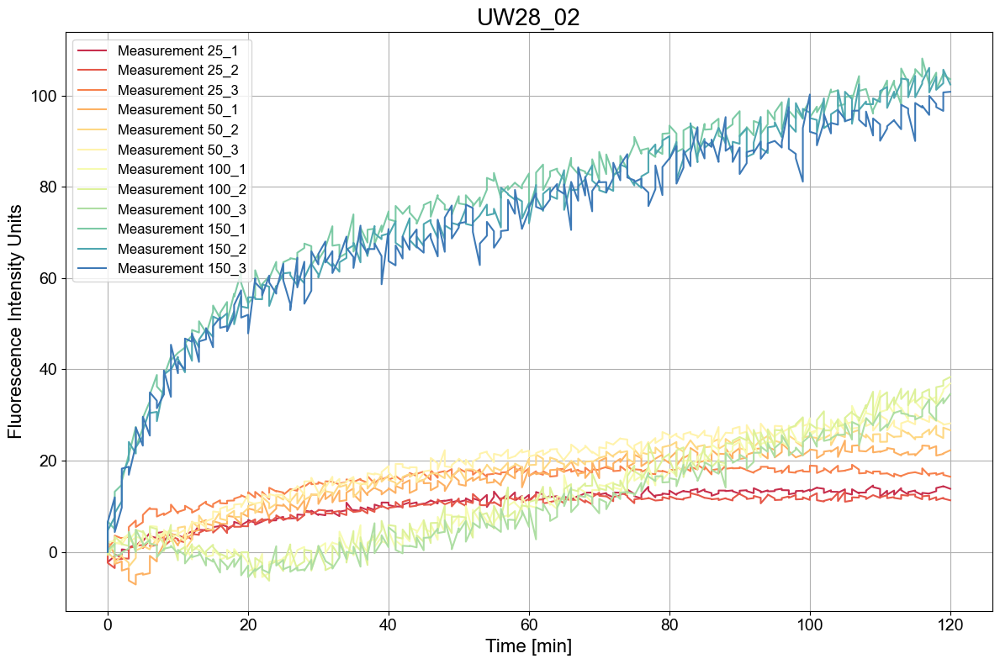

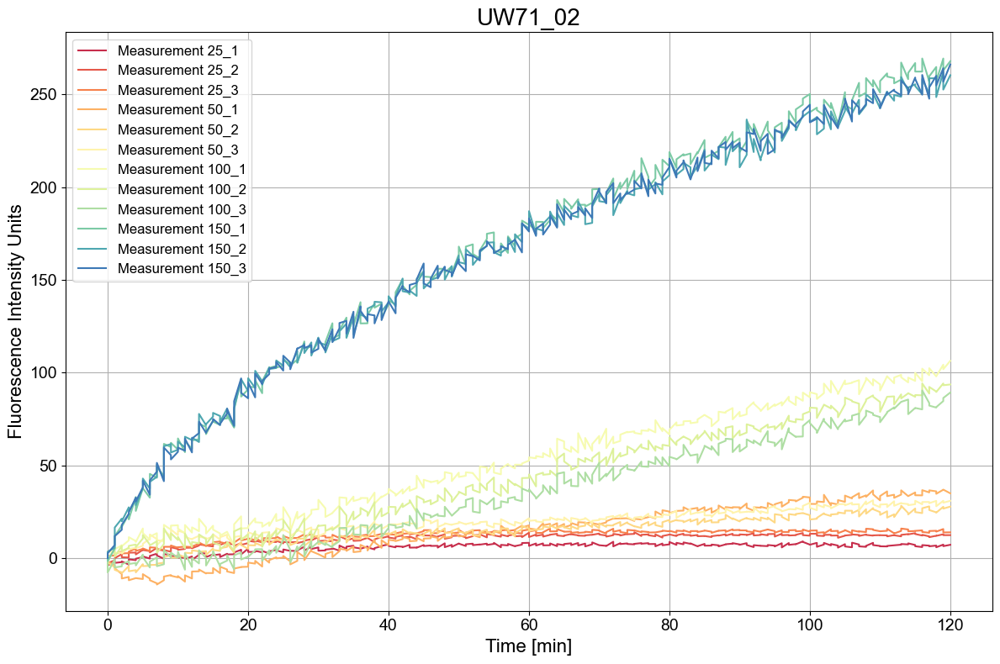

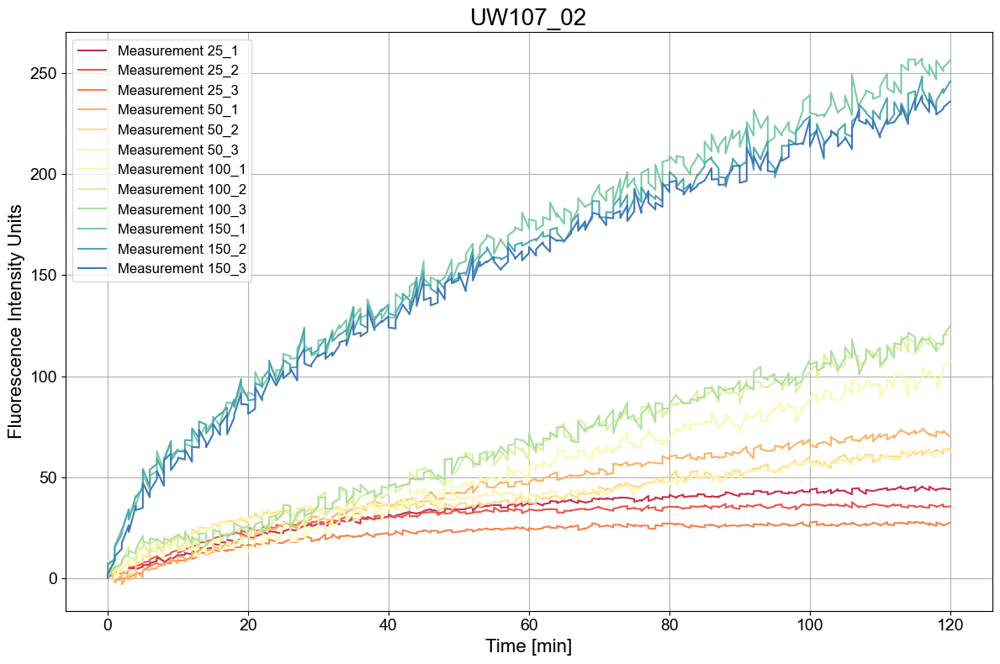

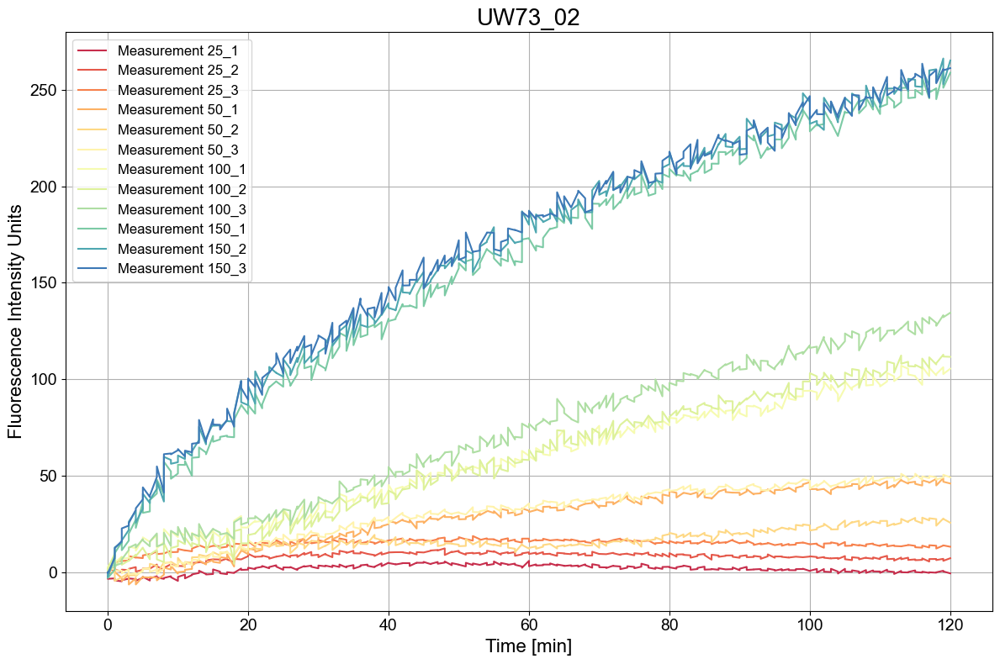

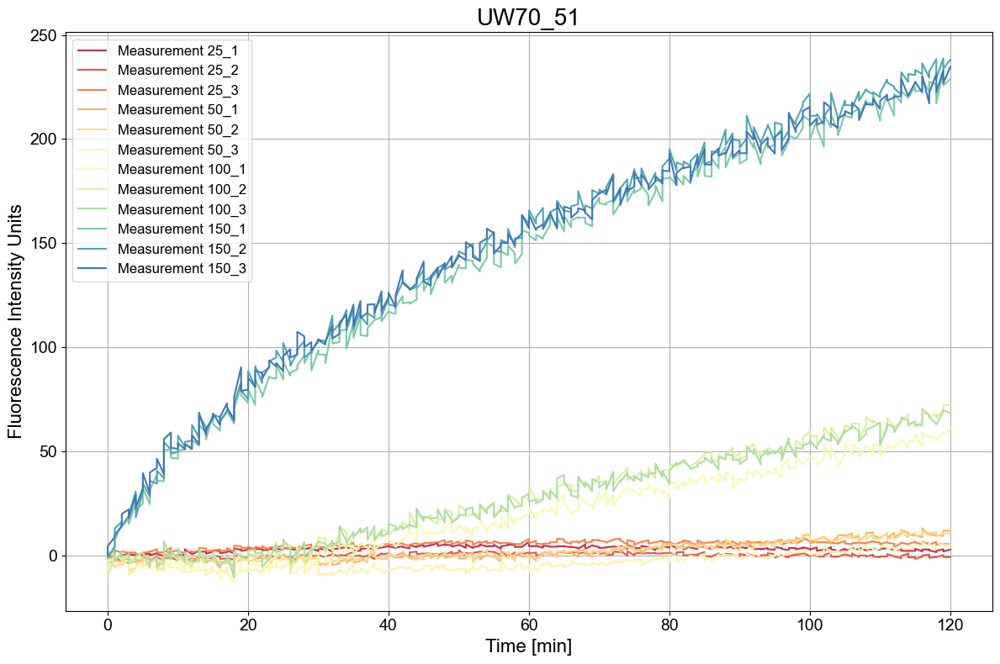

In [7]:
"""
This function can be used to plot the blank corrected fluorescence data against time.
Returns: plots of fluorescence vs. time in min.
By default this function will plot mean fluorescence vs. time, unless you specify in the second argument of the function 
to explicitly plot single measurements. 

ARGUMENTS: 
    * data_dic: Input dictionary with blank corrected fluorescence and time data
    * plots: This argument has two options: 
        * mean: plot the mean fluorescence vs. time (default)
        * triplicate: plots triplicate measurements vs. time
"""
def plot_flvstime(data_dic, plots='mean'):
    for key, df in data_dic.items():
        ## LETS PLOT OUR FIGURE
        plt.figure(figsize=(12, 8))

        if plots == 'triplicate':
            '''
            This section plots each measurement separately. 
            This is a little messy but can be helpful for quality control. 
            Later, when we want to assess the statistical significance of the v0 values, we need to use the single measurements. 
            '''
            # Convert time column values to units of hours using the timetohours() function and safe data to df as new column named 'Time_hr'
            df['Time_hr'] = df['Time'].apply(timetomin)
            # Normalize
            df = normalize(df)
            colors=sns.color_palette("Spectral", n_colors=12)
            # Iterate i through each triplicate column col (1, 2, 3) of each sample in the dataframe, excluding the Time column
            for i, col in enumerate(df.columns[1:13]): 
                # Create a plot of the selected triplicate columns (col) against the time in hours and add a label for each measurement
                plt.plot(df['Time_hr'], df[col], label=f"Measurement {col}", color=colors[i])
            plt.title(f"{key}", fontsize=20)
            plt.xticks(fontsize=14)
            plt.yticks(fontsize=14)
            plt.xlabel("Time [min]", fontsize=16)
            plt.ylabel(r'Fluorescence Intensity Units', fontsize=16)
            plt.legend(loc='upper left', fontsize='12')
            plt.grid()
            plt.tight_layout()
            plt.savefig(f"../data/Kinetics/intermediate_figures/{key}_triplicatekinetics.pdf", format='pdf')
            plt.show()
        
        else:
            '''
            Plots the mean of the triplicate measurements. 
            '''
            # Calculate the mean and std for each triplicates using the function mean_std() and assign to variables mean and std
            df = mean_std(df)
            # Convert time column values to units of hours using the timetohours() function and safe data to df as new column named 'Time_hr'
            df['Time_hr'] = df['Time'].apply(timetomin)
            # Normalize
            df = normalize(df)
            
            colors=sns.color_palette("Spectral", n_colors=4)
            for i, col in enumerate(df.columns[1:5]):
                plt.plot(df['Time_hr'], df[col],label=f"Measurement {col}", color=colors[i])
            
            # Customize the plot
            plt.title(f"{key}", fontsize=20)
            plt.xticks(fontsize=14)
            plt.yticks(fontsize=14)
            plt.xlabel("Time [min]", fontsize=16)
            plt.ylabel(r'Fluorescence Intensity Units', fontsize=16)
            plt.legend(loc='upper left', fontsize='12')
            plt.grid()
            plt.tight_layout()
    
            # Display the plot and save (optional, uncomment if you want to save in figures/ folder).
            plt.savefig(f"../data/Kinetics/intermediate_figures/{key}_meankinetics.pdf", format='pdf')
            plt.show()

plot_flvstime(fluorescence_dic, plots='mean')
plot_flvstime(fluorescence_dic, plots='triplicate')

In [8]:
"""
The function select_degree() helps us find the best degree polynomial to fit the data without under or overfitting.
It selects this degree based on the Bayesian information criterion.
    Parameters:
        * time:
        * values: 
        * max_degree:
    Returns:
        
"""

def select_degree(time, values, max_degree=15):
    results = []

    for d in range(1, max_degree + 1):
        try:
            poly = Polynomial.fit(time, values, d)
            poly_eval = poly(time)

            # Derivative
            deriv = poly.deriv()(time)
            max_deriv = np.max(deriv)
            std_deriv = np.std(deriv)

            # Fit quality
            rss = np.sum((values - poly_eval) ** 2)
            n = len(time)
            k = d + 1  # number of parameters
            eps = 1e-12
            aic = n * np.log(max(rss/n, eps)) + 2 * k
            bic = n * np.log(max(rss/n, eps)) + k * np.log(n)

            results.append({
                "degree": d,
                "R²": 1 - rss / np.sum((values - np.mean(values)) ** 2),
                "AIC": aic,
                "BIC": bic,
                "max_deriv": max_deriv,
                "std_deriv": std_deriv,
                "poly": poly
            })
        except Exception as e:
            print(f"Degree {d} failed: {e}")

    # Choose based on lowest BIC or some combination
    degree = min(results, key=lambda x: x["BIC"])
    return degree, results
    
"""
This function plots fluorescence kinetics with polynomial fitting and displays fit statistics.
    Parameters:
    
    Returns:
        - fit_stats: Dictionary with max derivative and fit statistics for each condition 
"""
def plot_kinetics(data_dic):
    for key, df in data_dic.items():
        fit_stats = {}  # Dictionary to store fit statistics
        # Extract clioXXX from the filename
        match = re.search(r"(clio\d+)", key)
        if match:
            foldername = match.group(1)
        else:
            foldername = key  # fallback

        basename = os.path.splitext(os.path.basename(key))[0]
        folder = f"../data/Kinetics/intermediate_figures/{foldername}"
        os.makedirs(folder, exist_ok=True)

        
        fig_path = os.path.join(folder, f"{basename}_polyfit.pdf")
        csv_path = os.path.join(folder, f"polyfit_data_{basename}.csv")
            
        #os.makedirs(f"./Figures/Polyfit/{foldername}", exist_ok=True)

        # Convert time column values to units of hours/minutes using timetomin() 
        df['Time_hr'] = df['Time'].apply(timetomin)
        time = df['Time_hr']

        # Normalize
        df = normalize(df)

        # Color palette
        colors = sns.color_palette("Spectral", n_colors=len(df.columns))

        plt.figure(figsize=(15, 8))

        # Loop over sample columns
        for i, col in enumerate(df.columns[1:13]):  
            if col != 'Time_hr':
                plt.plot(time, df[col], label=col, color=colors[i])
                
                try:
                    # Shift time so first point = 0
                    time0 = time - time.iloc[0]

                    # Select polynomial degree
                    best_result, _ = select_degree(time0, df[col])
                    degree = best_result["degree"]

                    # Fit polynomial with domain = data range
                    poly = Polynomial.fit(time0, df[col], degree, domain=[time0.min(), time0.max()])
                    poly_eval = poly(time0)

                    # Derivative
                    deriv_poly = poly.deriv()
                    deriv_values = deriv_poly(time0)

                    slope_t0 = deriv_poly(time0.iloc[0])          # slope at first timepoint
                    max_slope = np.max(deriv_values)   # maximum slope

                    # Fit statistic R²
                    R2 = 1 - np.sum((df[col] - poly_eval) ** 2) / np.sum((df[col] - np.mean(df[col])) ** 2)

                    # Store results
                    fit_stats[col] = {
                        "derivative_t0": slope_t0,
                        "max_derivative": max_slope,
                        "degree": degree,
                        "R²": R2
                    }

                    # Plot polynomial fit
                    plt.plot(time, poly_eval, '--', color=colors[i], alpha=0.8, label=f"{col} (Poly Fit)")

                except Exception as e:
                    print(f"Error in fitting polynomial for {col}: {e}")

        # Finalize plot
        plt.title(f"{key}", fontsize=20)
        plt.xlabel('Time [min]')
        plt.ylabel('Fluorescence Intensity')
        plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
        plt.savefig(fig_path, format='pdf')
        plt.show()
        plt.close()

        # Save fit statistics
        with open(csv_path, "w", newline="") as file:
            fieldnames = ["Condition", "derivative_t0", "max_derivative", "degree", "R²"]
            writer = csv.DictWriter(file, fieldnames=fieldnames)
            writer.writeheader()
            for condition, stats in fit_stats.items():
                writer.writerow({"Condition": condition, **stats})

    return fit_stats

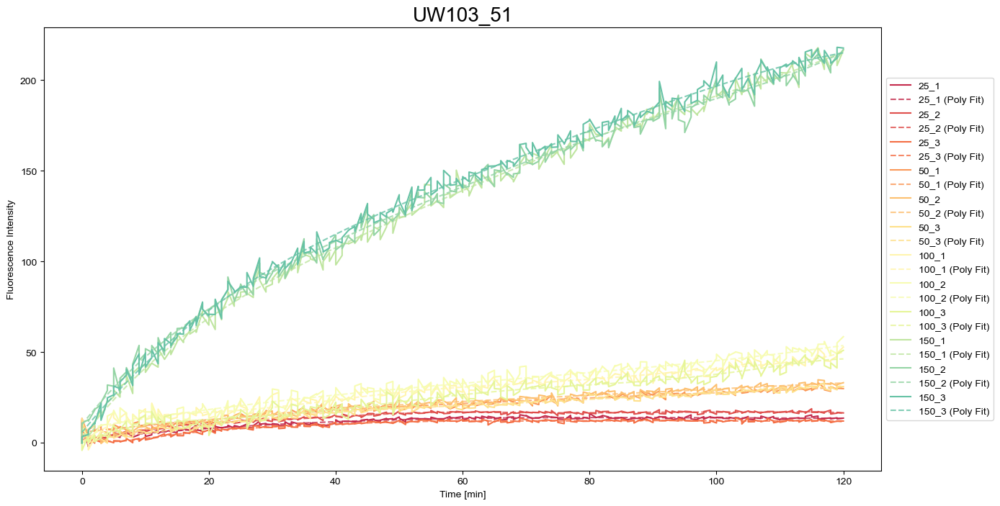

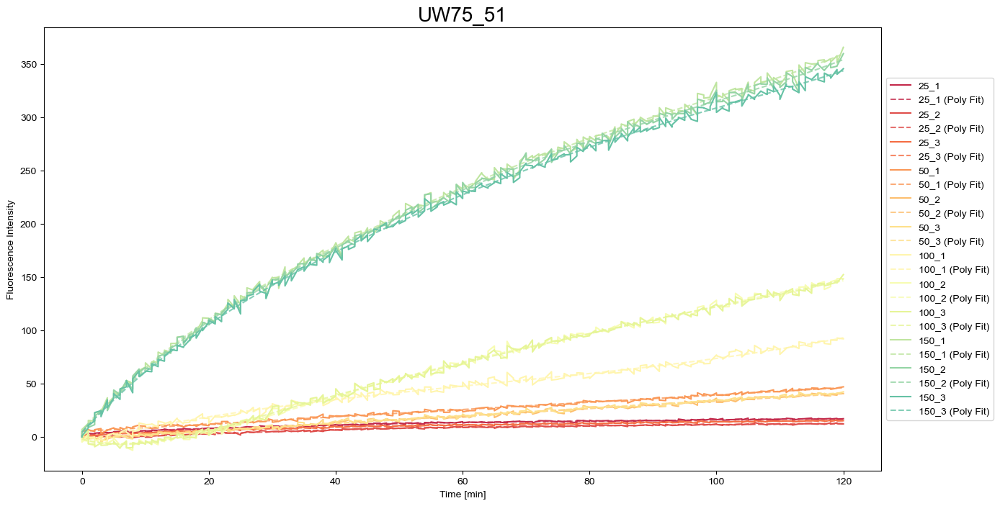

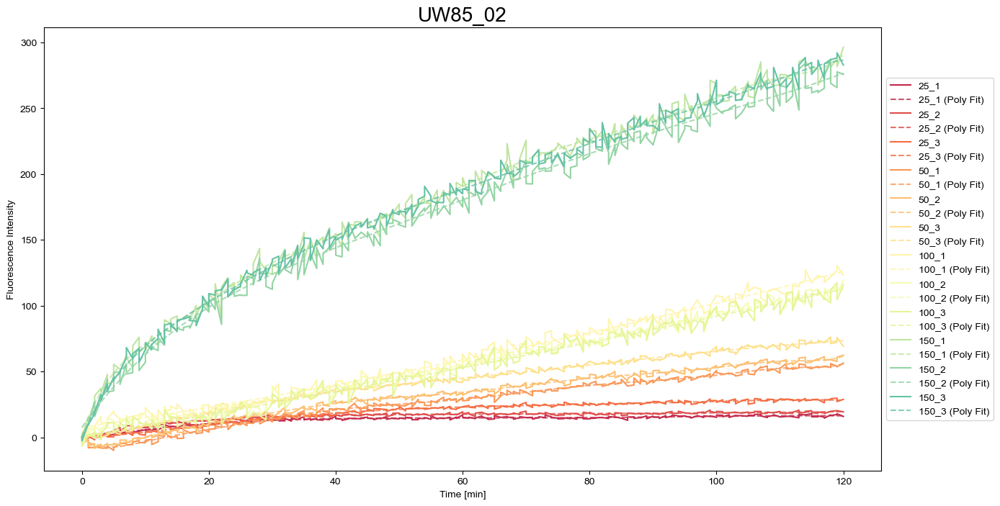

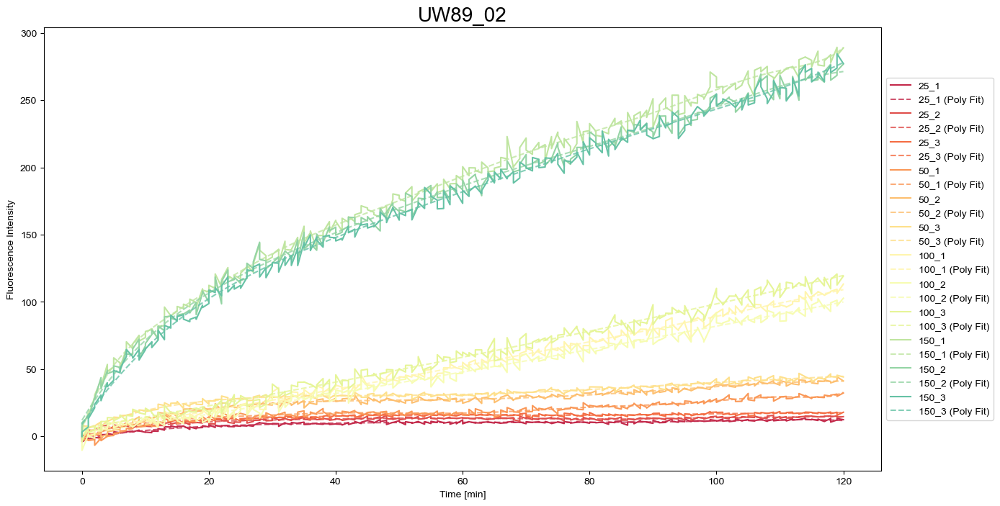

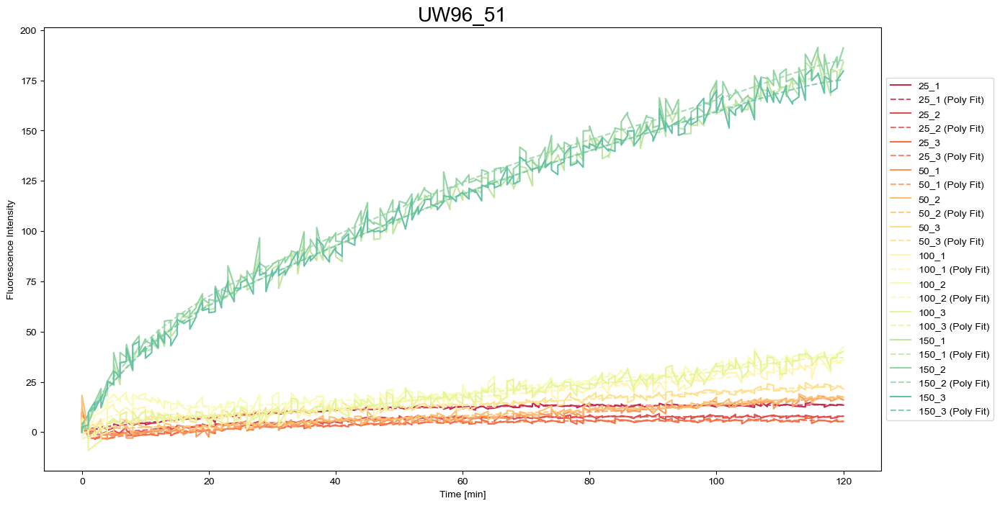

...

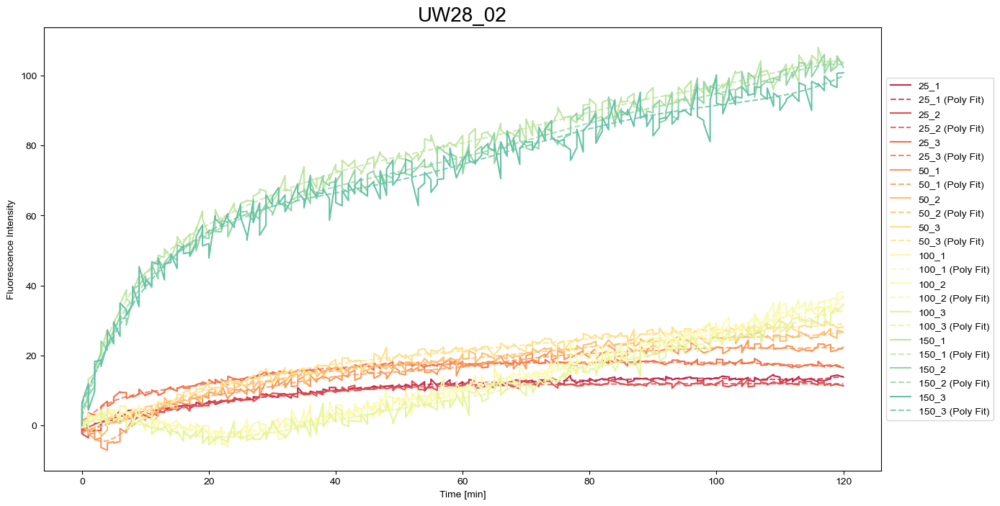

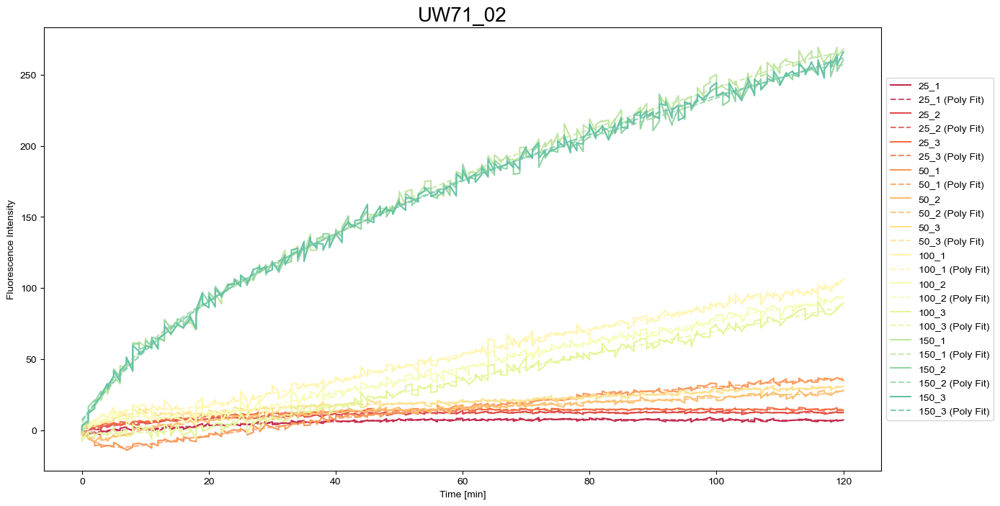

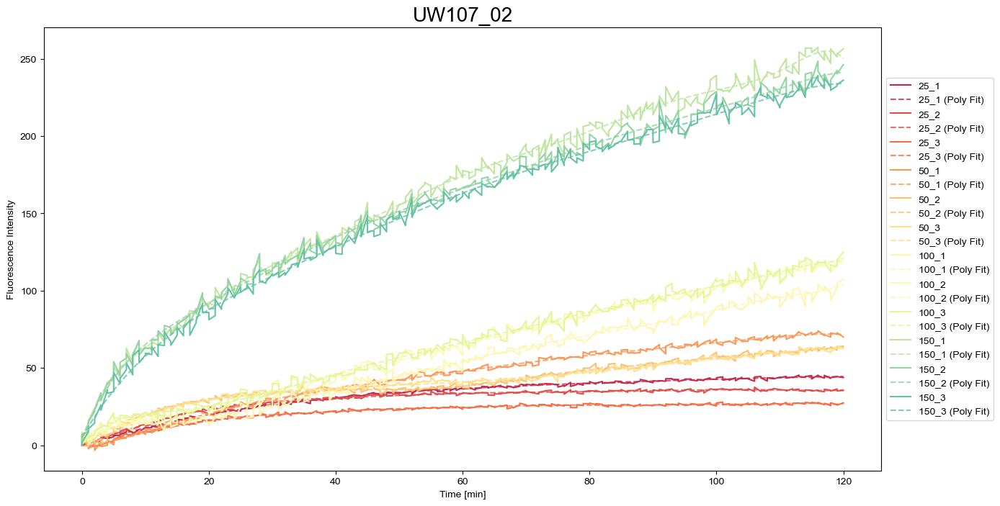

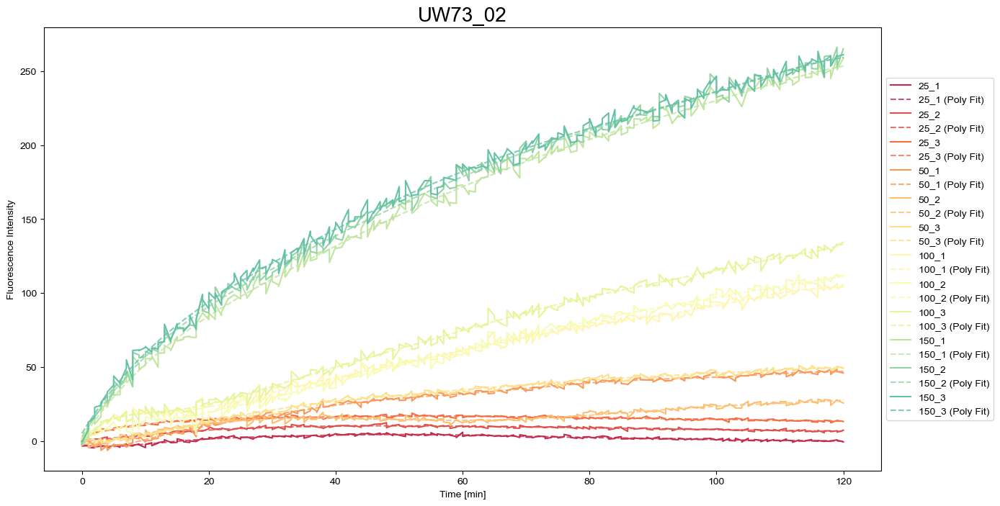

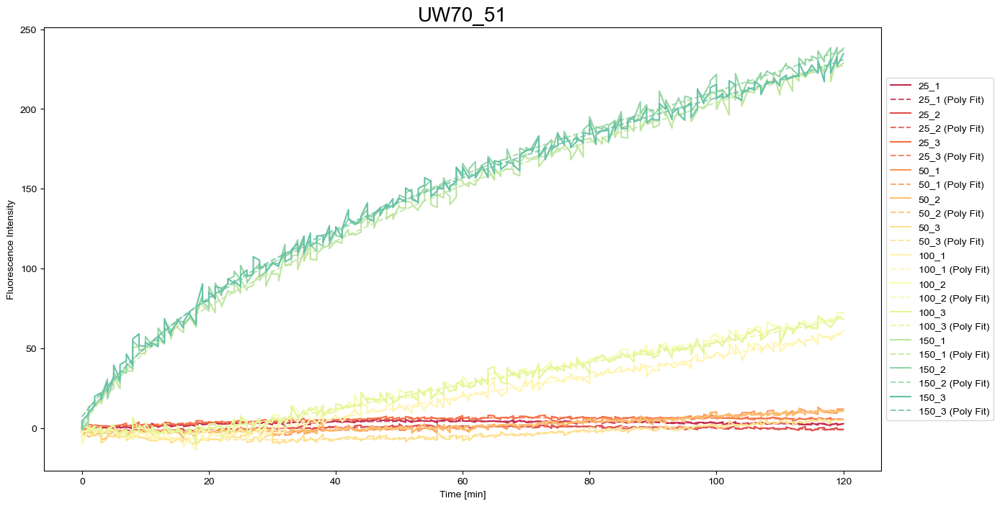

{'25_1': {'derivative_t0': np.float64(0.20277209187522932),
  'max_derivative': np.float64(0.20277209187522932),
  'degree': 3,
  'R²': np.float64(0.7862331909016671)},
 '25_2': {'derivative_t0': np.float64(0.10075090452999039),
  'max_derivative': np.float64(0.10075090452999039),
  'degree': 2,
  'R²': np.float64(0.6015388853084891)},
 '25_3': {'derivative_t0': np.float64(0.1776472761353713),
  'max_derivative': np.float64(0.1776472761353713),
  'degree': 3,
  'R²': np.float64(0.8456601971912387)},
 '50_1': {'derivative_t0': np.float64(-0.1077618504482073),
  'max_derivative': np.float64(0.19197275282701248),
  'degree': 3,
  'R²': np.float64(0.9119912056323691)},
 '50_2': {'derivative_t0': np.float64(0.01585791633427379),
  'max_derivative': np.float64(0.22129502433456377),
  'degree': 2,
  'R²': np.float64(0.90044272795496)},
 '50_3': {'derivative_t0': np.float64(-0.21058385349590233),
  'max_derivative': np.float64(0.18491487134303525),
  'degree': 3,
  'R²': np.float64(0.890594924

In [9]:
plot_kinetics(fluorescence_dic)

## Step 5: Protease Activity Summary


In [11]:
"""
The function summarize_derivatives() takes all files and summarizes the data in files created as output from plot_kinetics() and saves
them as pd dataframe as well as a combined summary file called derivatives_summary.csv. 

ARGUMENTS: 
    * input_folder: Input directory containing the polyfit_data*.csv files that were created as output from plot_kinetics()

OUTPUTS: 
    * derivatives_summary.csv: file containing derivatives for all conditions, their mean and standard deviation. 
"""
def summarize_derivatives(input_folder=''):
    summary_data = []

    # Go through all the polyfit output files
    for file in glob.glob(os.path.join(input_folder, "polyfit_data_*.csv")):
        key = os.path.basename(file).replace("polyfit_data_", "").replace(".csv", "")
        df = pd.read_csv(file)

        # Extract base condition (25, 50, etc.) by splitting before the "_"
        df['Condition'] = df['Condition'].str.extract(r'(\d+)_')
        df['Dataset'] = key
        
        # Mean/Std 
        condition_stats = df.groupby('Condition')['derivative_t0'].agg(['mean', 'std']).reset_index()
        condition_stats.columns = ['Condition', 'Mean', 'Std']
        df = df.merge(condition_stats, on='Condition', how='left')

        summary_data.append(df[['Condition', 'derivative_t0', 'Dataset', 'Mean', 'Std']])

    # Combine all summaries into a single DataFrame
    summary_df = pd.concat(summary_data, ignore_index=True)
    
    # Save summary
    summary_df.to_csv(os.path.join(input_folder, "derivatives_summary.csv"), index=False)
    print(f"Saved summary to: {os.path.join(input_folder, 'derivatives_summary.csv')}")
    return summary_df

In [12]:
summarize_derivatives('../data/Kinetics/polyfit/')

Saved summary to: ../data/Kinetics/polyfit/derivatives_summary.csv


,Condition,derivative_t0,Dataset,Mean,Std
0,25,0.382514,UW103_51,-0.620370,0.918981
1,25,-0.821489,UW103_51,-0.620370,0.918981
2,25,-1.422135,UW103_51,-0.620370,0.918981
3,50,0.399177,UW103_51,0.369388,0.365675
4,50,0.719258,UW103_51,0.369388,0.365675
...,...,...,...,...,...
199,100,3.690916,UW99_51,5.024929,1.973641
200,100,4.091759,UW99_51,5.024929,1.973641
201,150,4.332495,UW99_51,4.455526,0.570633
202,150,3.956444,UW99_51,4.455526,0.570633


## Step 6: Kinetics Data Plotting

### 6.1 Clio Profiles

In [ ]:
def profile(df=''):
    key = df['Dataset'].str.extract(r'^(clio\d{3})')[0].iloc[0]
    # --- Prep data ---
    df['Depth'] = df['Dataset'].str.extract(r'(\d+)m').astype(int)
    df['Filter'] = df['Dataset'].str.extract(r'_(\d{2})_')
    df['Condition_type'] = df['Filter'] + df['Dataset'].str.contains('EDTA').map({True: '_EDTA', False: ''})
    
    plot_df = df[['Condition', 'Depth', 'Condition_type', 'Mean', 'Std']].drop_duplicates()
    plot_df = plot_df[plot_df['Mean'] >= 0].copy()
    
    # --- Colors for condition types ---
    palette = sns.color_palette("viridis", n_colors=plot_df['Condition_type'].nunique())
    cond_colors = dict(zip(plot_df['Condition_type'].unique(), palette))
    
    # --- Make subplots per substrate concentration ---
    conditions = sorted(plot_df['Condition'].unique())
    fig, axes = plt.subplots(1, len(conditions), figsize=(16, 6), sharey=True)
    
    for ax, cond in zip(axes, conditions):
        sub = plot_df[plot_df['Condition'] == cond]
        
        for ctype in sub['Condition_type'].unique():
            df_cond = sub[sub['Condition_type'] == ctype]
            df_cond['fmol'] = df_cond['Mean'] * 2.5
            ax.errorbar(
                df_cond['fmol'], df_cond['Depth'],
                xerr=df_cond['Std'],
                fmt='o', label=ctype,
                color=cond_colors[ctype], capsize=3, markersize=8
            )
        
        ax.set_title(f"Condition {cond}")
        ax.set_xlabel("Proteolysis Rate at T$_0$", fontsize=20)
        ax.tick_params(labelsize = 18)
        ax.set_xlim(0,80)
        ax.set_ylim(0,1700)
        
    axes[0].set_ylabel("Depth (m)", fontsize=20)
    axes[-1].legend(title="Condition", bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=18)
    ax.invert_yaxis()
    
    plt.tight_layout()
    plt.savefig(f"./Figures/Profiles/{key}_profile.pdf", format='pdf')
    plt.show()

/var/folders/hb/hntvhz5j0j15vb_5h21tbhph0000gn/T/ipykernel_86137/905302415.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_cond['fmol'] = df_cond['Mean'] * 2.5
/var/folders/hb/hntvhz5j0j15vb_5h21tbhph0000gn/T/ipykernel_86137/905302415.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_cond['fmol'] = df_cond['Mean'] * 2.5
/var/folders/hb/hntvhz5j0j15vb_5h21tbhph0000gn/T/ipykernel_86137/905302415.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Tr

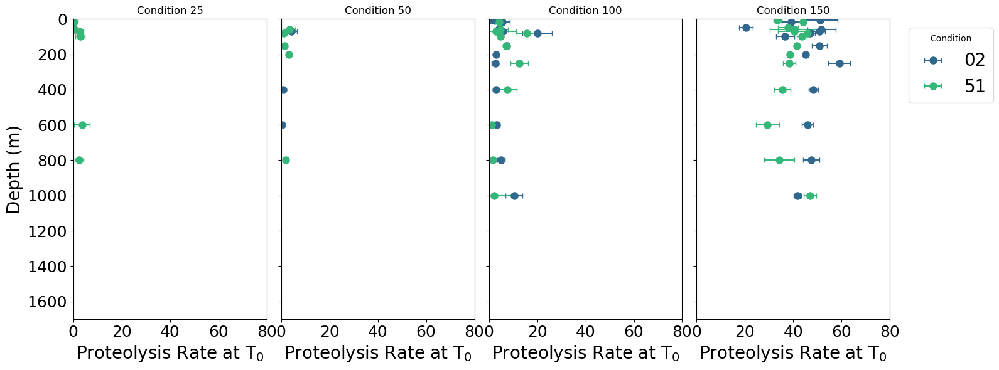

/var/folders/hb/hntvhz5j0j15vb_5h21tbhph0000gn/T/ipykernel_86137/905302415.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_cond['fmol'] = df_cond['Mean'] * 2.5
/var/folders/hb/hntvhz5j0j15vb_5h21tbhph0000gn/T/ipykernel_86137/905302415.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_cond['fmol'] = df_cond['Mean'] * 2.5
/var/folders/hb/hntvhz5j0j15vb_5h21tbhph0000gn/T/ipykernel_86137/905302415.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Tr

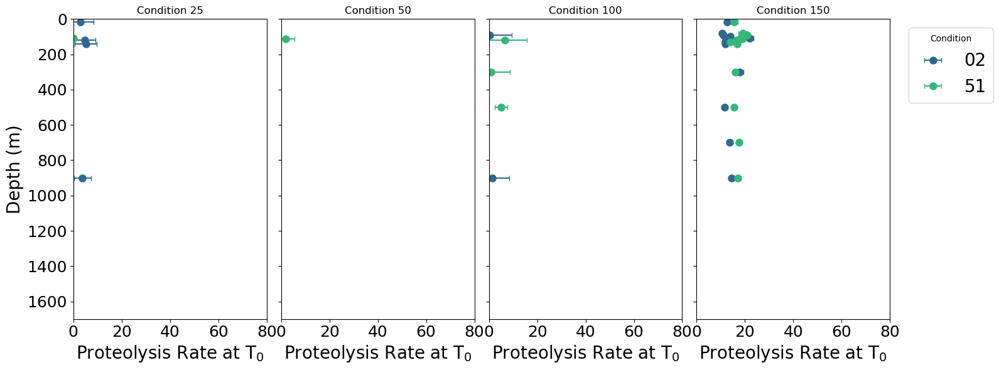

/var/folders/hb/hntvhz5j0j15vb_5h21tbhph0000gn/T/ipykernel_86137/905302415.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_cond['fmol'] = df_cond['Mean'] * 2.5
/var/folders/hb/hntvhz5j0j15vb_5h21tbhph0000gn/T/ipykernel_86137/905302415.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_cond['fmol'] = df_cond['Mean'] * 2.5
/var/folders/hb/hntvhz5j0j15vb_5h21tbhph0000gn/T/ipykernel_86137/905302415.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Tr

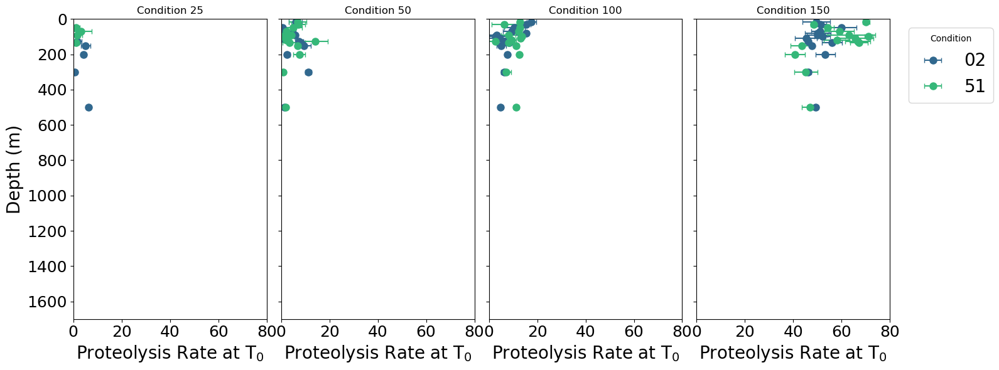

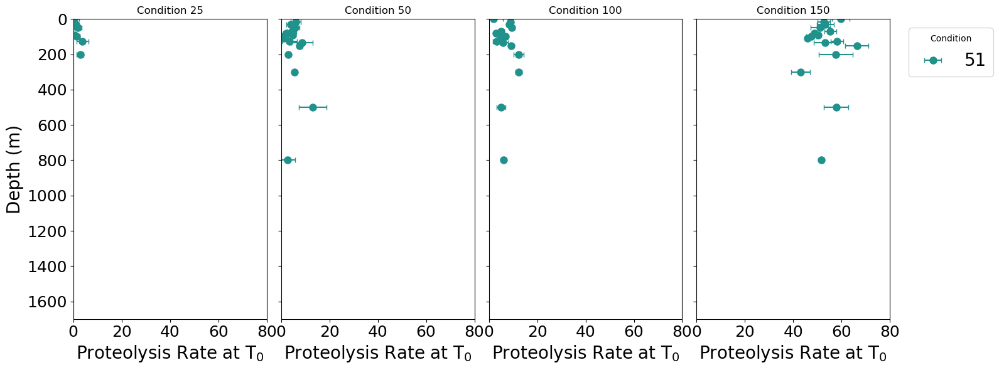

/var/folders/hb/hntvhz5j0j15vb_5h21tbhph0000gn/T/ipykernel_86137/905302415.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_cond['fmol'] = df_cond['Mean'] * 2.5
/var/folders/hb/hntvhz5j0j15vb_5h21tbhph0000gn/T/ipykernel_86137/905302415.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_cond['fmol'] = df_cond['Mean'] * 2.5
/var/folders/hb/hntvhz5j0j15vb_5h21tbhph0000gn/T/ipykernel_86137/905302415.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Tr

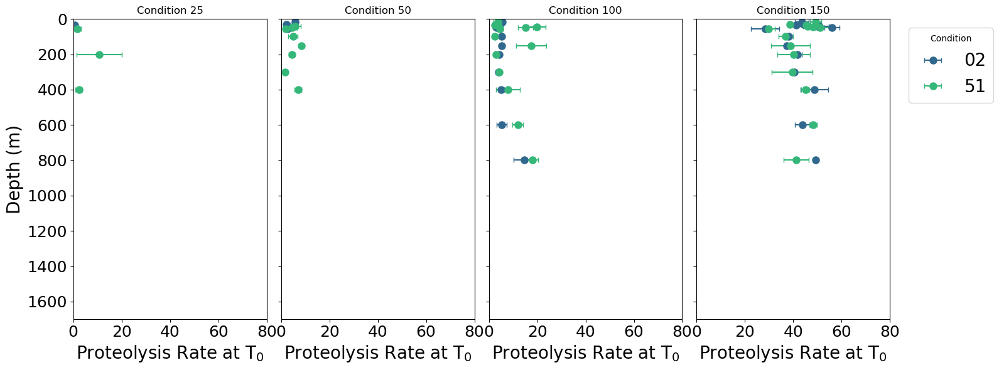

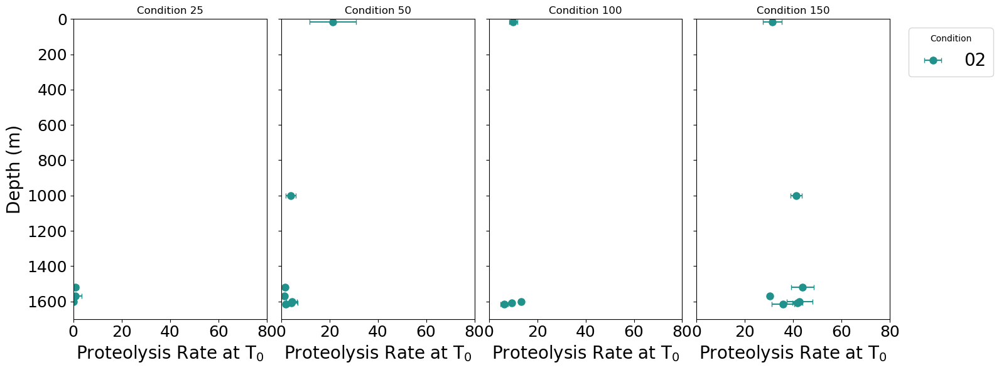

In [24]:
clio056 = pd.read_csv('./Figures/Polyfit/clio056/derivatives_summary.csv', delimiter=',')
clio057 = pd.read_csv('./Figures/Polyfit/clio057/derivatives_summary.csv', delimiter=',')
clio058 = pd.read_csv('./Figures/Polyfit/clio058/derivatives_summary.csv', delimiter=',')
clio059 = pd.read_csv('./Figures/Polyfit/clio059/derivatives_summary.csv', delimiter=',')
clio060 = pd.read_csv('./Figures/Polyfit/clio060/derivatives_summary.csv', delimiter=',')
clio061 = pd.read_csv('./Figures/Polyfit/clio061/derivatives_summary.csv', delimiter=',')

profile(clio056)
profile(clio057)
profile(clio058)
profile(clio059)
profile(clio060)
profile(clio061)

### 6.2 Underway profiles

In [2]:
df = pd.read_csv('../data/Kinetics/total_protein.csv', delimiter=',')

# Convert mean and std from FI/min to fmol FTC-Casein degraded per min. 
df['Mean_scaled'] = 2.5 * df['Mean']
df['Std_scaled'] = 2.5 * df['Std']

# Extract Sample (UW number) and Fraction
df['Sample'] = df['Dataset'].str.split('_').str[0]
df['Fraction'] = df['Dataset'].str.split('_').str[1]

# Extract numeric part for sorting
df['Sample_num'] = df['Sample'].str.extract(r'(\d+)').astype(int)

# Reduce to unique rows: one per Sample × Fraction
plot_df = df[['Condition', 'Sample', 'Sample_num', 'Fraction', 'Mean_scaled', 'Std_scaled']].drop_duplicates()

# Sort by numeric value
plot_df = plot_df.sort_values('Sample_num')

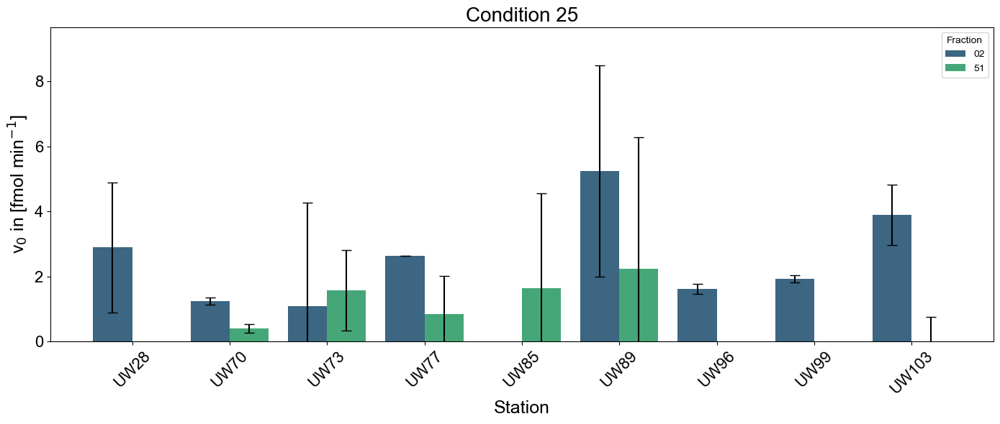

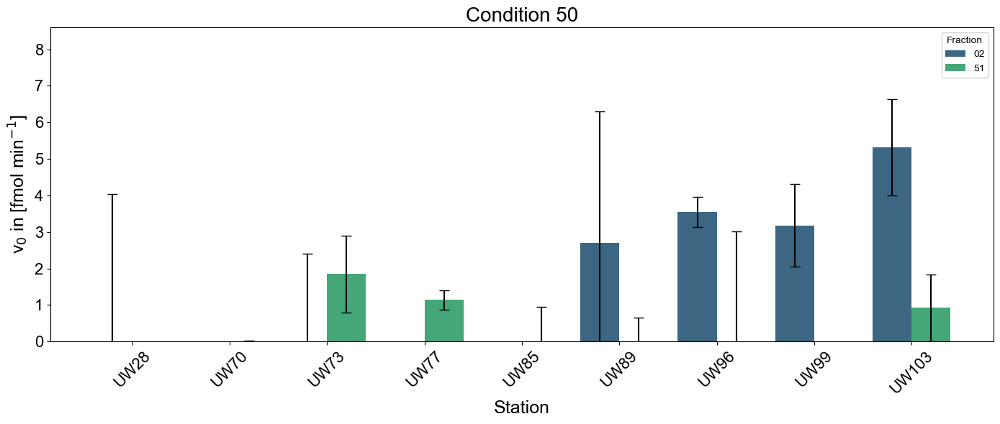

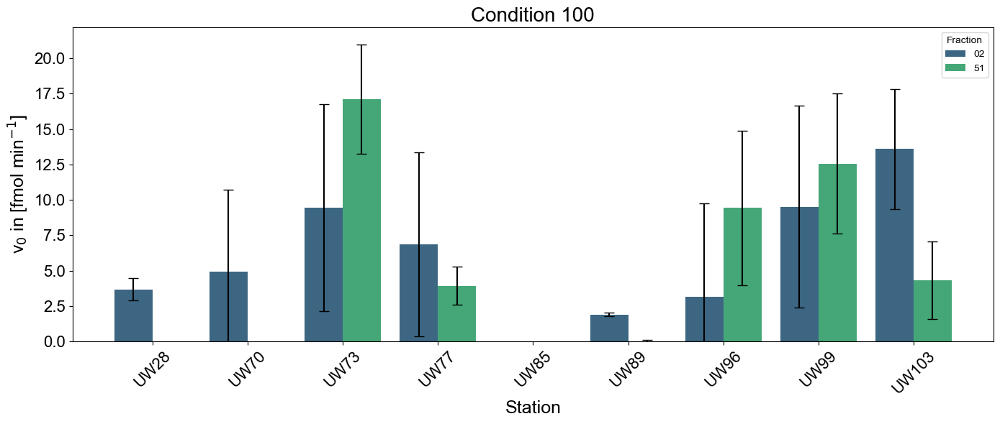

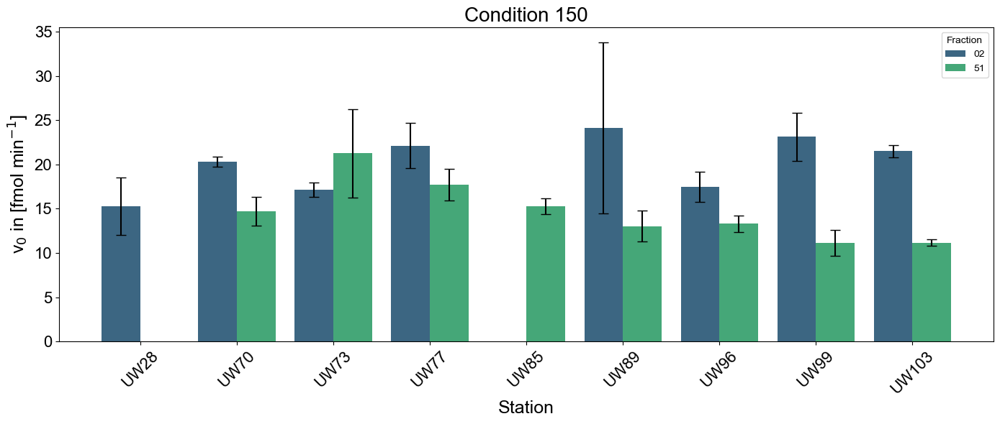

In [3]:
conditions = sorted(plot_df['Condition'].unique())
fractions = sorted(plot_df['Fraction'].unique())
palette = sns.color_palette("viridis", n_colors=len(fractions))

for cond in conditions:
    cond_df = plot_df[plot_df['Condition'] == cond].copy()
    cond_df = cond_df.sort_values('Sample_num')
    
    plt.figure(figsize=(14,6))
    
    ax = sns.barplot(
        data=cond_df,
        x='Sample',
        y='Mean_scaled',
        hue='Fraction',
        palette=palette,
        errorbar=None,
        order=cond_df['Sample'].unique(),
        hue_order=fractions
    )
    
    # Map sample names to x-axis positions
    xticks = {label.get_text(): i for i, label in enumerate(ax.get_xticklabels())}
    
    # Bar width in seaborn is approx 0.8 / n_fractions
    bar_width = 0.8 / len(fractions)
    
    for i, row in cond_df.iterrows():
        sample = row['Sample']
        fraction = row['Fraction']
        yerr = row['Std_scaled']
        
        # x-position: left edge + fraction offset + half bar
        x = xticks[sample] - 0.4 + fractions.index(fraction) * bar_width + bar_width/2
        
        ax.errorbar(
            x=x,
            y=row['Mean_scaled'],
            yerr=yerr,
            fmt='none',
            c='black',
            capsize=5
        )
    
    ax.set_ylabel("v$_{0}$ in [fmol min$^{-1}$]", fontsize=18)
    ax.set_xlabel("Station", fontsize=18)
    ax.set_ylim(0)
    
    plt.xticks(rotation=45, fontsize=16)
    plt.yticks(fontsize=16)
    plt.title(f"Condition {cond}", fontsize=20)
    plt.tight_layout()
    plt.savefig(f"../figures/OSM2026/protease_activity/AE2504_UW_activity_{cond}.pdf", format='pdf')
    plt.show()

## Normalization 
Prior to plotting the data we finally want to normalize by total protein amount, filter size and liters seawater filtered. We can use the metaP data for this. From the protein extractions we get the total protein in µg/µl for each sample. This data is stored in the file: '../Data/metadata_UW.txt' and in '../Data/ProteaseAssays_Underway/total_protein.csv'.

### NORMALIZATION OPTIONS
1) 'none'
2) 'per_L'
3) 'per_total_protein'
4) 'per_protease'

In [4]:
def plot_kinetics(df, normalization="none", scale_factor=2.5):

    df = df.copy()

    # Convert FI/min → fmol/min
    df["Mean_scaled"] = scale_factor * df["Mean"]
    df["Std_scaled"] = scale_factor * df["Std"]

    # Extract Sample (UW number) and Fraction
    df["Sample"] = df["Dataset"].str.split("_").str[0]
    df["Fraction"] = df["Dataset"].str.split("_").str[1]
    df["Sample_num"] = df["Sample"].str.extract(r"(\d+)").astype(int)

    # Average replicates (important!)
    df = (
        df.groupby(
            ["Condition", "Sample", "Sample_num", "Fraction"],
            as_index=False
        )
        .mean(numeric_only=True)
    )
    print(df)

    # -----------------------
    # NORMALIZATION SWITCH
    # -----------------------

    if normalization == "none":
        df["activity"] = df["Mean_scaled"]
        ylabel = "v$_{0}$ in [fmol min$^{-1}$]"

    elif normalization == "per_L":
        df["activity"] = df["Mean_scaled"] / df["volume_filtered"]
        df["Std_activity"] = df["Std_scaled"] / df["volume_filtered"]
        ylabel = "Activity [fmol min$^{-1}$ L$^{-1}$]"

    elif normalization == "per_total_protein":
        df["activity"] = df["Mean_scaled"] / df["total_protein_ug"]
        df["Std_activity"] = df["Std_scaled"] / df["total_protein_ug"]
        ylabel = "Specific activity [fmol min$^{-1}$ µg$^{-1}$ protein]"

    elif normalization == "per_protease":
        df["activity"] = df["Mean_scaled"] / df["ec_total_proteases_ugL"]
        df["Std_activity"] = df["Std_scaled"] / df["ec_total_proteases_ugL"]
        ylabel = "Protease-specific activity [fmol min$^{-1}$ (µg L$^{-1}$)$^{-1}$]"

    else:
        raise ValueError("Invalid normalization option")

    # If no normalization, std already correct
    if normalization == "none":
        df["Std_activity"] = df["Std_scaled"]

    # -----------------------
    # PLOTTING
    # -----------------------

    conditions = sorted(df["Condition"].unique())
    fractions = sorted(df["Fraction"].unique())

    for cond in conditions:

        cond_df = df[df["Condition"] == cond].copy()
        cond_df = cond_df.sort_values("Sample_num")

        plt.figure(figsize=(14, 6))

        ax = sns.barplot(
            data=cond_df,
            x="Sample",
            y="activity",
            hue="Fraction",
            palette="viridis",
            errorbar=None,
            order=cond_df["Sample"].unique(),
            hue_order=fractions
        )

        # Map sample names to x positions
        xticks = {label.get_text(): i for i, label in enumerate(ax.get_xticklabels())}
        n_fractions = len(fractions)
        bar_width = 0.8 / n_fractions  # approximate
        
        for i, row in cond_df.iterrows():
            sample = row['Sample']
            fraction = row['Fraction']
            
            x = xticks[sample] - 0.4 + fractions.index(fraction) * bar_width + bar_width/2
            
            ax.errorbar(
                x=x,
                y=row['activity'],
                yerr=row['Std_activity'],
                fmt='none',
                c='black',
                capsize=5
            )

        ax.set_ylabel(ylabel, fontsize=18)
        ax.set_xlabel("Station", fontsize=18)

        plt.xticks(rotation=45, fontsize=16)
        plt.yticks(fontsize=16)
        plt.title(f"Condition {cond}", fontsize=20)
        plt.savefig(f"../figures/OSM2026/protease_activity/AE2504_UW_activity_{cond}_{normalization}.pdf", format='pdf')
        plt.tight_layout()
        plt.show()

    Condition Sample  Sample_num Fraction  derivative_t0      Mean       Std  \
0          25  UW103         103       02       1.556799  1.556799  0.373662   
1          25  UW103         103       51      -0.620370 -0.620370  0.918981   
2          25   UW28          28       02       1.158738  1.158738  0.802076   
3          25   UW70          70       02       0.495185  0.495185  0.042663   
4          25   UW70          70       51       0.160390  0.160390  0.053155   
..        ...    ...         ...      ...            ...       ...       ...   
59        150   UW89          89       51       5.214683  5.214683  0.705270   
60        150   UW96          96       02       6.998222  6.998222  0.683138   
61        150   UW96          96       51       5.319914  5.319914  0.379697   
62        150   UW99          99       02       9.247023  9.247023  1.100796   
63        150   UW99          99       51       4.455526  4.455526  0.570633   

    protein_conc_ugul  total_protein_ug

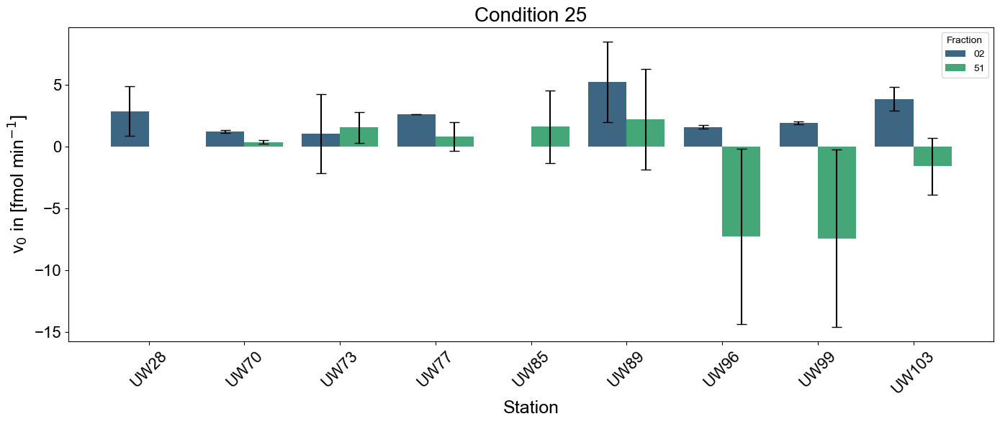

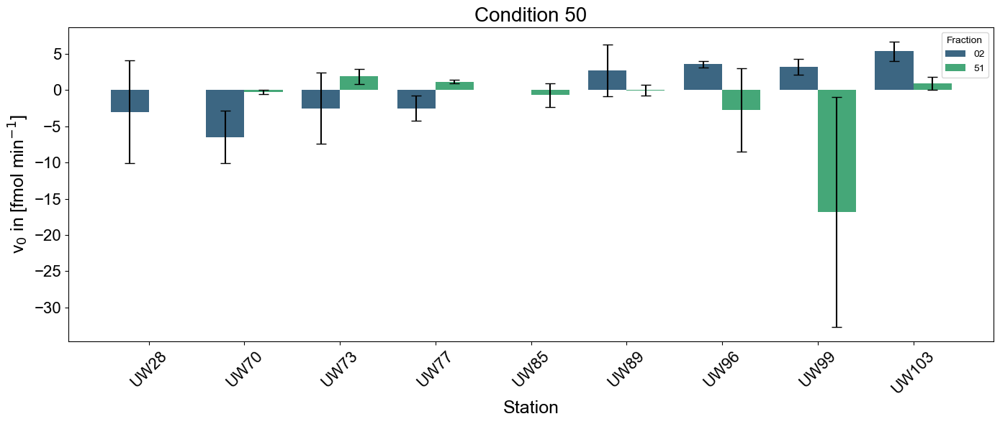

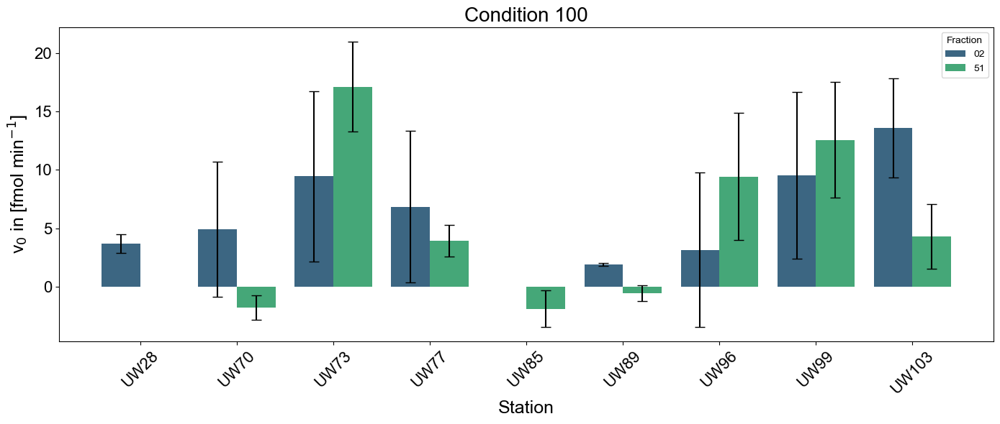

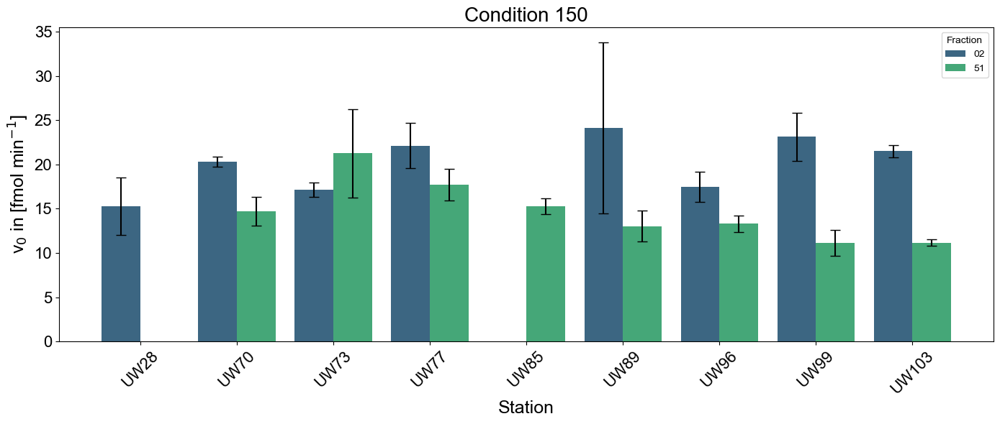

    Condition Sample  Sample_num Fraction  derivative_t0      Mean       Std  \
0          25  UW103         103       02       1.556799  1.556799  0.373662   
1          25  UW103         103       51      -0.620370 -0.620370  0.918981   
2          25   UW28          28       02       1.158738  1.158738  0.802076   
3          25   UW70          70       02       0.495185  0.495185  0.042663   
4          25   UW70          70       51       0.160390  0.160390  0.053155   
..        ...    ...         ...      ...            ...       ...       ...   
59        150   UW89          89       51       5.214683  5.214683  0.705270   
60        150   UW96          96       02       6.998222  6.998222  0.683138   
61        150   UW96          96       51       5.319914  5.319914  0.379697   
62        150   UW99          99       02       9.247023  9.247023  1.100796   
63        150   UW99          99       51       4.455526  4.455526  0.570633   

    protein_conc_ugul  total_protein_ug

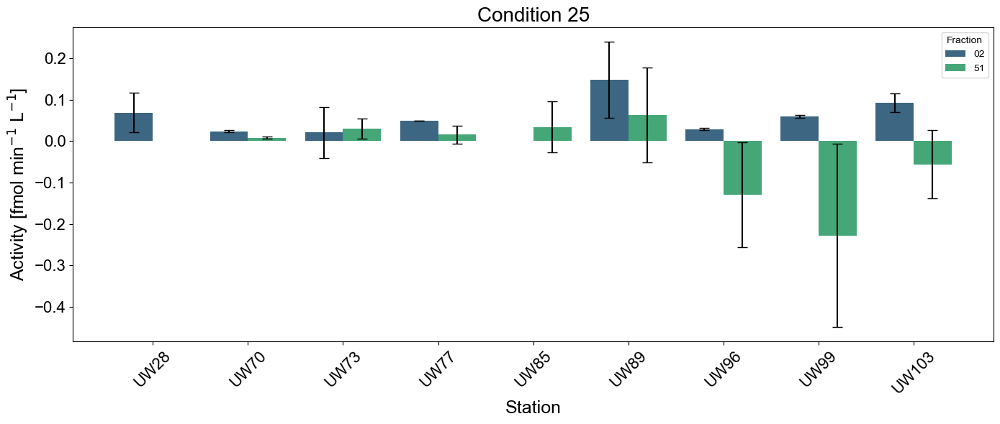

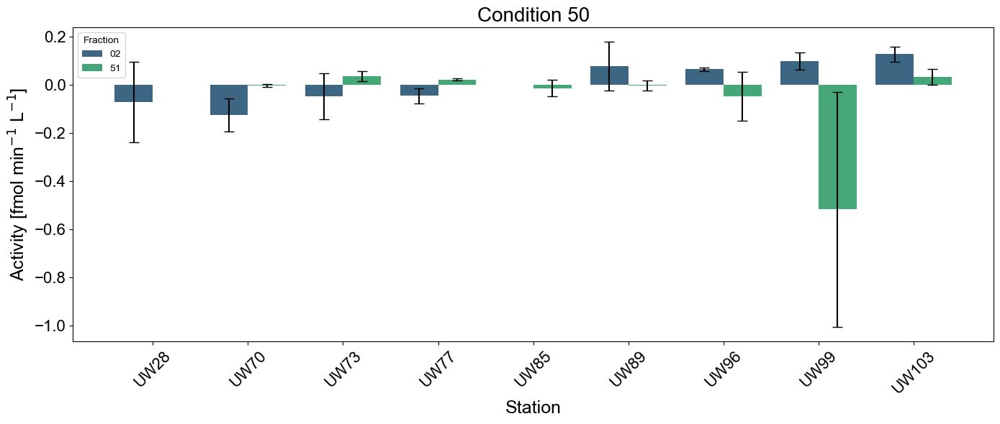

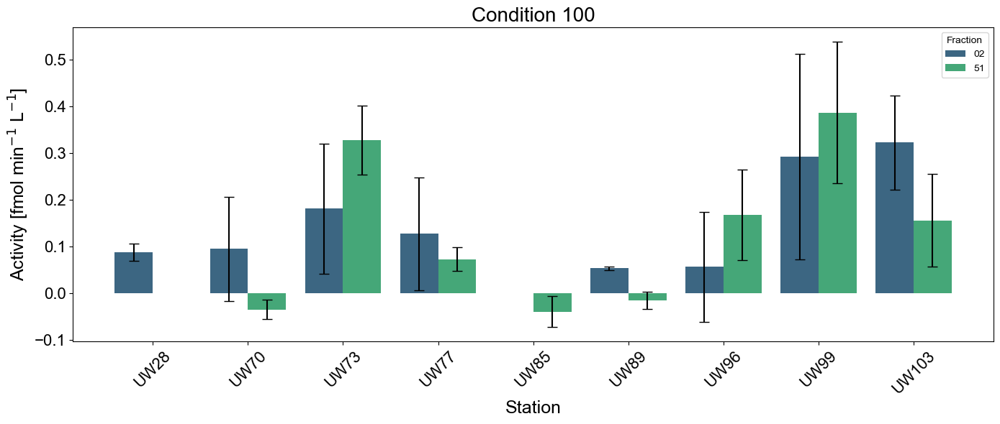

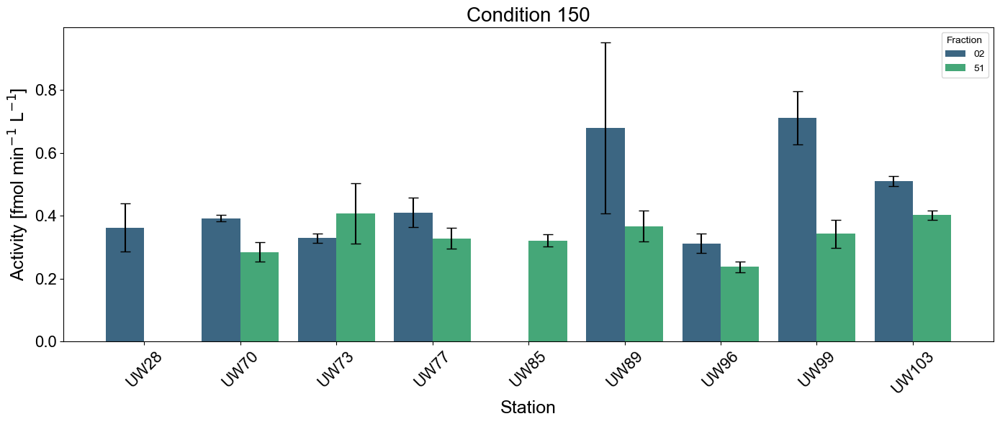

    Condition Sample  Sample_num Fraction  derivative_t0      Mean       Std  \
0          25  UW103         103       02       1.556799  1.556799  0.373662   
1          25  UW103         103       51      -0.620370 -0.620370  0.918981   
2          25   UW28          28       02       1.158738  1.158738  0.802076   
3          25   UW70          70       02       0.495185  0.495185  0.042663   
4          25   UW70          70       51       0.160390  0.160390  0.053155   
..        ...    ...         ...      ...            ...       ...       ...   
59        150   UW89          89       51       5.214683  5.214683  0.705270   
60        150   UW96          96       02       6.998222  6.998222  0.683138   
61        150   UW96          96       51       5.319914  5.319914  0.379697   
62        150   UW99          99       02       9.247023  9.247023  1.100796   
63        150   UW99          99       51       4.455526  4.455526  0.570633   

    protein_conc_ugul  total_protein_ug

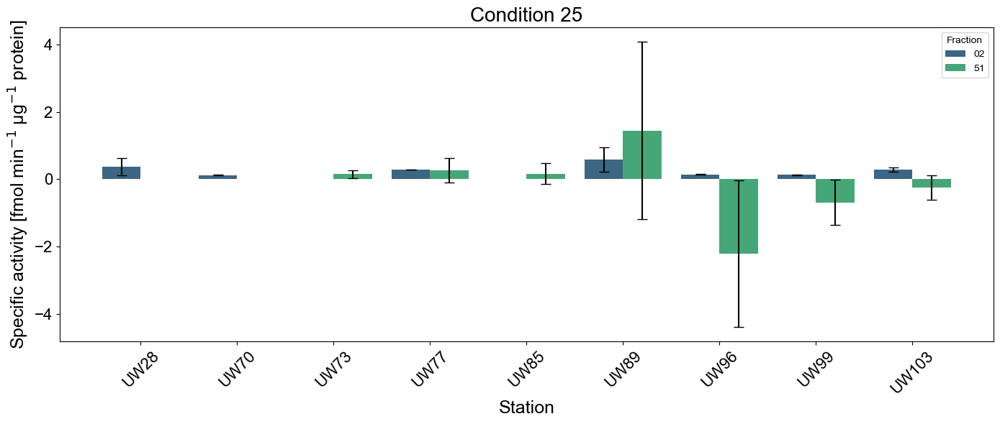

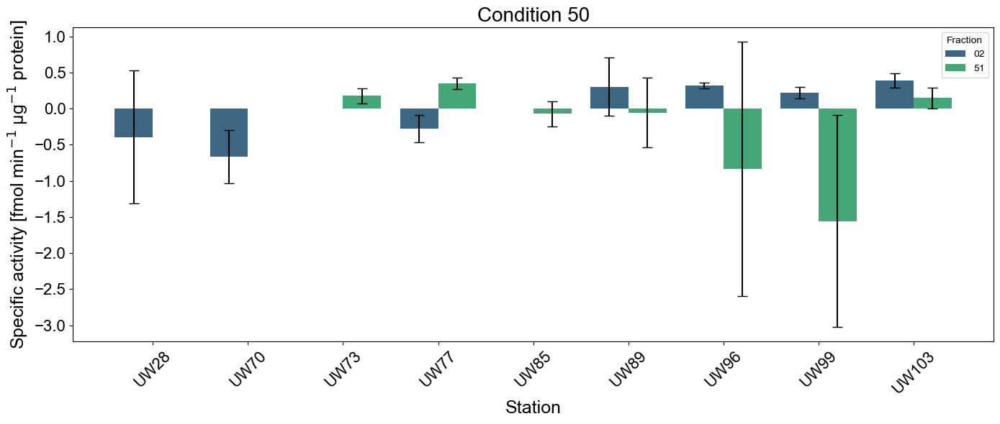

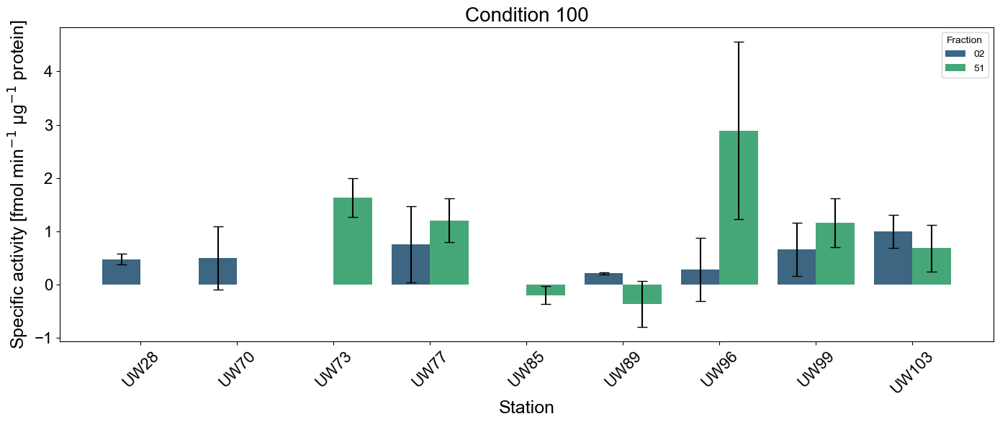

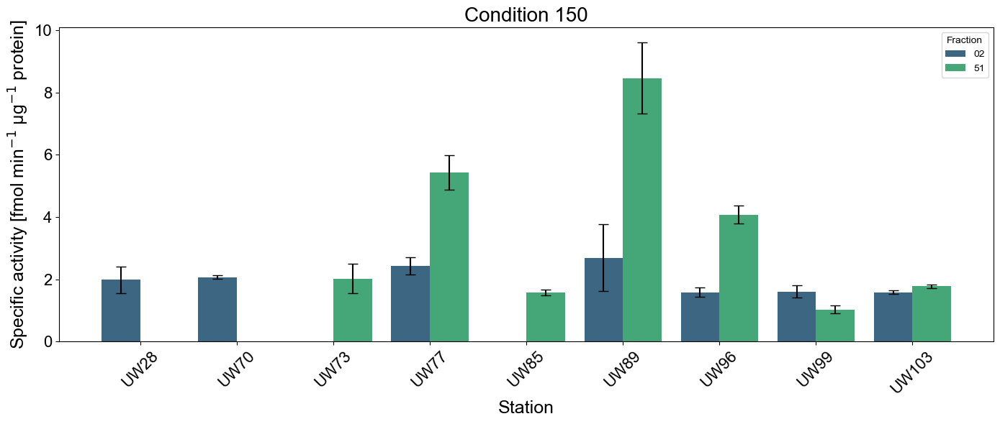

    Condition Sample  Sample_num Fraction  derivative_t0      Mean       Std  \
0          25  UW103         103       02       1.556799  1.556799  0.373662   
1          25  UW103         103       51      -0.620370 -0.620370  0.918981   
2          25   UW28          28       02       1.158738  1.158738  0.802076   
3          25   UW70          70       02       0.495185  0.495185  0.042663   
4          25   UW70          70       51       0.160390  0.160390  0.053155   
..        ...    ...         ...      ...            ...       ...       ...   
59        150   UW89          89       51       5.214683  5.214683  0.705270   
60        150   UW96          96       02       6.998222  6.998222  0.683138   
61        150   UW96          96       51       5.319914  5.319914  0.379697   
62        150   UW99          99       02       9.247023  9.247023  1.100796   
63        150   UW99          99       51       4.455526  4.455526  0.570633   

    protein_conc_ugul  total_protein_ug

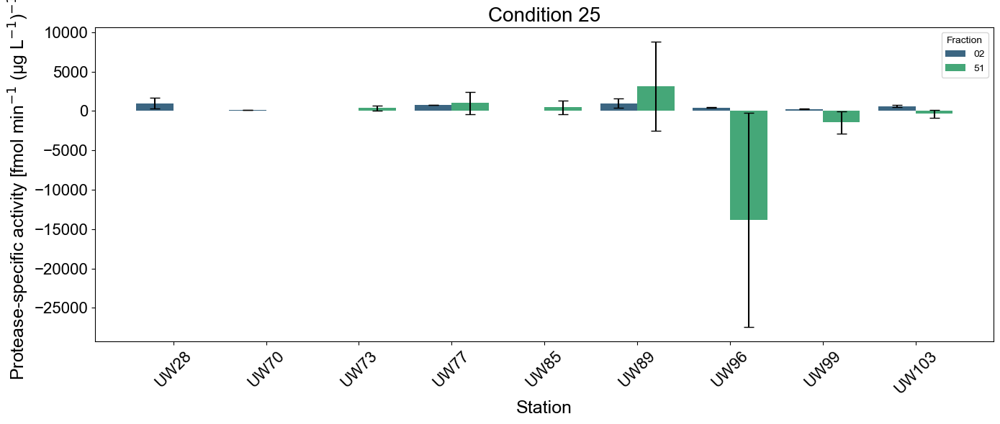

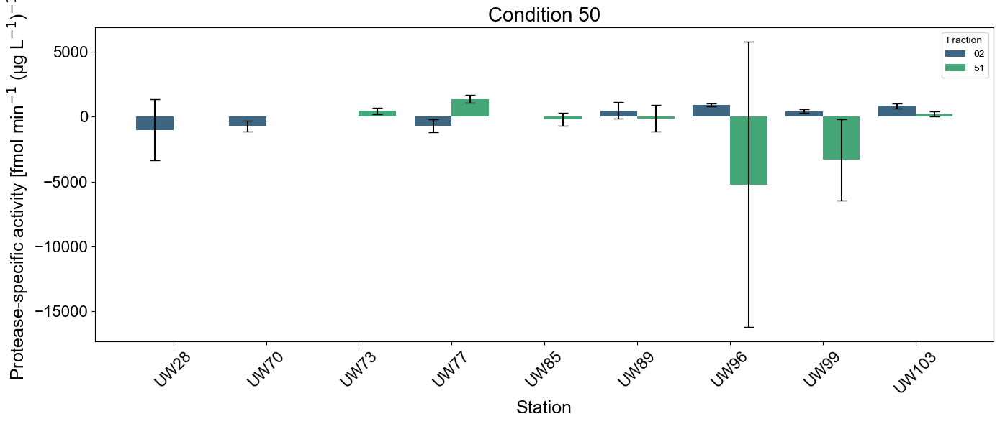

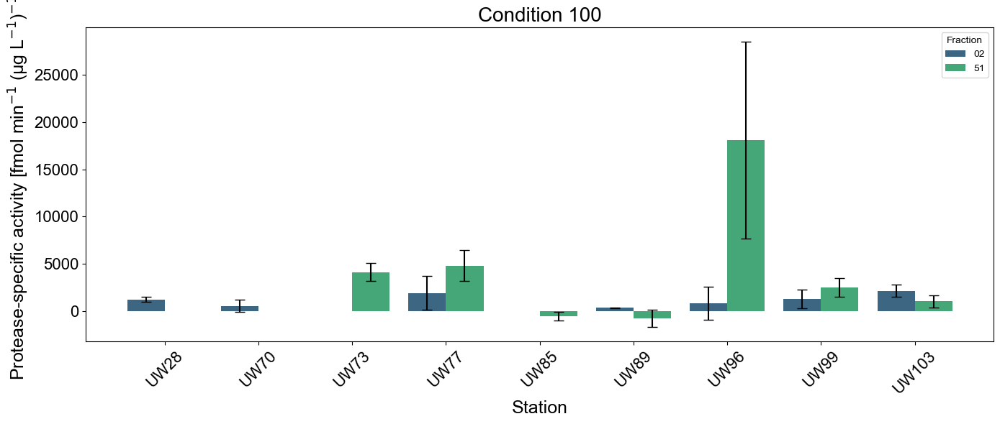

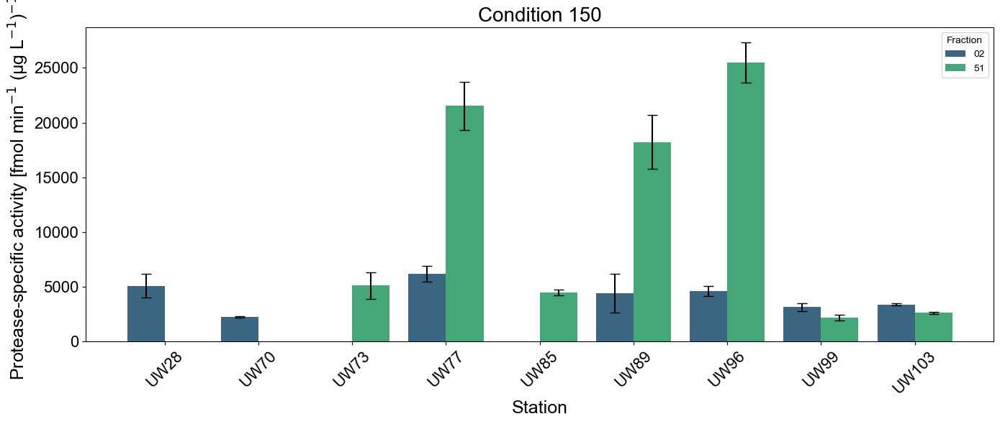

In [5]:
plot_kinetics(df, normalization='none' )
plot_kinetics(df, normalization='per_L' )
plot_kinetics(df, normalization='per_total_protein')
plot_kinetics(df, normalization='per_protease' )

In [6]:
def plot_protease_control(df, condition=150, scale_factor=2.5):
    df = df.copy()

    # --- Convert FI/min → fmol/min ---
    df["v0"] = scale_factor * df["Mean"]
    df["Std_v0"] = scale_factor * df["Std"]

    # --- Extract metadata ---
    df["Sample"] = df["Dataset"].str.split("_").str[0]
    df["Fraction"] = df["Dataset"].str.split("_").str[1]
    df["Sample_num"] = df["Sample"].str.extract(r"(\d+)").astype(int)

    # --- Average technical replicates only ---
    df = (
        df.groupby(
            ["Condition", "Sample", "Sample_num", "Fraction"],
            as_index=False
        )
        .mean(numeric_only=True)
    )

    # --- Filter condition ---
    df = df[df["Condition"] == condition].copy()

    if df.empty:
        print(f"No data found for condition {condition}")
        return

    df = df.sort_values("Sample_num")

    # --- Metrics ---
    df["activity_per_L"] = df["v0"] / df["volume_filtered"]
    df["Std_per_L"] = df["Std_v0"] / df["volume_filtered"]

    df["protease_ugL"] = df["ec_total_proteases_ugL"]

    df["activity_per_protease"] = df["v0"] / df["ec_total_proteases_ugL"]
    df["Std_per_protease"] = df["Std_v0"] / df["ec_total_proteases_ugL"]

    # --------------------------
    # Fraction & sample info
    # --------------------------
    fractions = sorted(df["Fraction"].unique())
    samples_sorted = df.sort_values("Sample_num")["Sample"].unique()
    n_fractions = len(fractions)
    bar_width = 0.8 / n_fractions  # approximate seaborn bar width per fraction

    # ==============================
    # Create figure
    # ==============================
    fig, axes = plt.subplots(2, 1, figsize=(14, 10), sharex=True)

    # ==========================================================
    # PANEL 1: Activity per L (bars) + Protease abundance (lines)
    # ==========================================================
    ax1 = axes[0]

    sns.barplot(
        data=df,
        x="Sample",
        y="activity_per_L",
        hue="Fraction",
        palette="viridis",
        errorbar=None,
        hue_order=fractions,
        order=samples_sorted,
        ax=ax1
    )

    # Map sample names to x-axis positions
    xticks = {label.get_text(): i for i, label in enumerate(ax1.get_xticklabels())}

    # Add error bars safely
    # Safe x-position using order, no reliance on tick labels
    for i, row in df.iterrows():
        sample = row["Sample"]
        fraction = row["Fraction"]
    
        if sample not in samples_sorted:
            continue
    
        x = list(samples_sorted).index(sample) - 0.4 + fractions.index(fraction) * bar_width + bar_width/2
    
        ax1.errorbar(
            x=x,
            y=row["activity_per_L"],
            yerr=row["Std_per_L"],
            fmt="none",
            c="black",
            capsize=4
        )

    ax1.set_ylabel("Bulk protease activity [fmol min$^{-1}$ L$^{-1}$]", fontsize=18)
    ax1.set_ylim(bottom=0)
    ax1.tick_params(axis="both", labelsize=18)

    # Secondary axis for protease abundance
    ax2 = ax1.twinx()

    # Plot protease lines for each fraction
    for frac, color in zip(["02", "51"], ["blue", "green"]):
        df_frac = df[df["Fraction"] == frac]
        if not df_frac.empty:
            ax2.plot(
                df_frac["Sample"],
                df_frac["protease_ugL"],
                marker="o",
                linewidth=2,
                color=color,
                label=f"Protease {frac} µm"
            )

    ax2.set_ylabel("Protease concentration [µg L$^{-1}$]", fontsize=18)
    ax2.set_ylim(bottom=0)
    ax2.legend(loc="upper right")
    ax2.tick_params(axis="both", labelsize=18)

    # ==========================================================
    # PANEL 2: Protease-specific activity
    # ==========================================================
    ax3 = axes[1]

    sns.barplot(
        data=df,
        x="Sample",
        y="activity_per_protease",
        hue="Fraction",
        palette="viridis",
        errorbar=None,
        hue_order=fractions,
        order=samples_sorted,
        ax=ax3
    )

    # Map sample names to x-axis positions for panel 2
    xticks2 = {label.get_text(): i for i, label in enumerate(ax3.get_xticklabels())}

    for i, row in df.iterrows():
        sample = row["Sample"]
        fraction = row["Fraction"]

        if sample not in xticks2:
            continue  # skip missing bars

        x = xticks2[sample] - 0.4 + fractions.index(fraction) * bar_width + bar_width/2

        ax3.errorbar(
            x=x,
            y=row["activity_per_protease"],
            yerr=row["Std_per_protease"],
            fmt="none",
            c="black",
            capsize=4
        )

    ax3.set_ylabel("Protease activity per protease \n[fmol min$^{-1}$ (µg L$^{-1}$)$^{-1}$]", fontsize=18)
    ax3.set_ylim(bottom=0)
    ax3.set_xlabel("Station", fontsize=18)
    ax3.tick_params(axis="both", labelsize=18)
    
    plt.tight_layout()
    plt.savefig('../figures/Fig8_UW_proteaseactivity.pdf', format='pdf')
    plt.show()

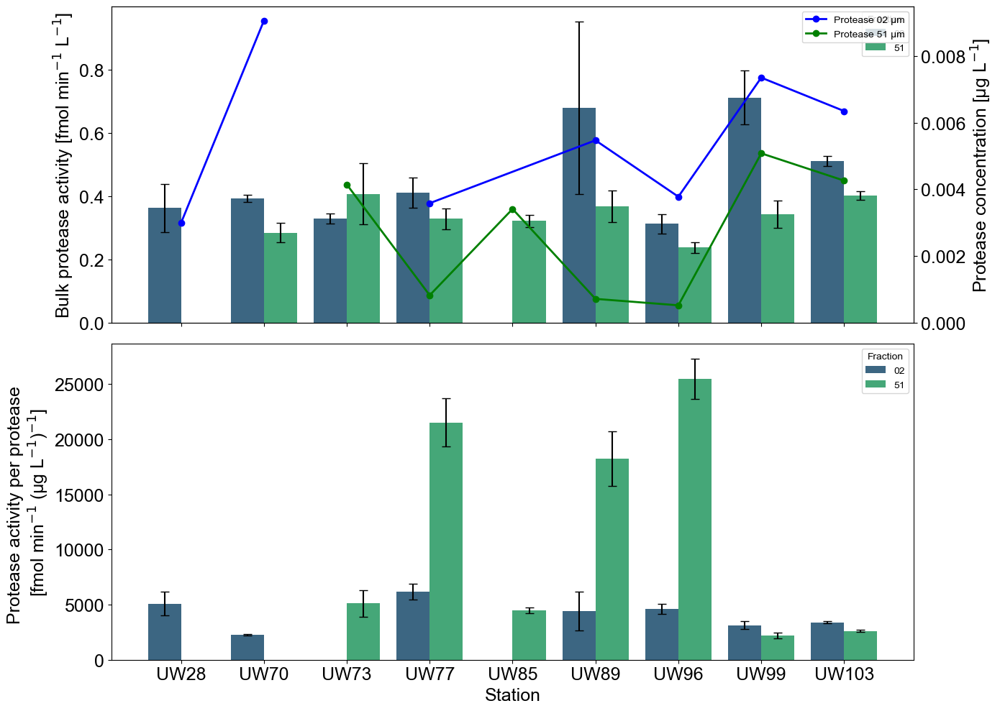

In [7]:
plot_protease_control(df)